This document covers the EDA (Exploratory Data Analysis) phase.

#Install and import libraries

Installation of Spark in Google Colab (Code extracted from: https://www.pauldesalvo.com/how-to-install-spark-on-google-colab/)

In [ ]:
!sudo apt update
!apt-get install openjdk-8-jdk-headless -qq > /dev/null
!wget -q https://dlcdn.apache.org/spark/spark-3.2.1/spark-3.2.1-bin-hadoop3.2.tgz
!tar xf spark-3.2.1-bin-hadoop3.2.tgz
!pip install -q findspark
!pip install pyspark

import os
os.environ["JAVA_HOME"] = "/usr/lib/jvm/java-8-openjdk-amd64"
os.environ["SPARK_HOME"] = "/content/spark-3.2.1-bin-hadoop3.2"

import findspark
findspark.init()
findspark.find()

from pyspark.sql import DataFrame, SparkSession
from typing import List
import pyspark.sql.types as T
import pyspark.sql.functions as F

spark = SparkSession \
       .builder \
       .appName("Our First Spark example") \
       .getOrCreate()

spark

Hit:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:2 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Ign:3 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:4 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Get:5 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Hit:6 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease
Hit:7 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:8 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Hit:10 http://ppa.launchpad.net/cran/libgit2/ubuntu bionic InRelease
Hit:11 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu bionic InRelease
Get:12 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 kB]
Hit:13 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease
Get:14 http://security.ubuntu.com/ubuntu

Import other needed libraries

In [ ]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     - 21.8 MB 148 kB/s
     |████████████████████████████████| 596 kB 6.2 MB/s 
     |████████████████████████████████| 102 kB 48.6 MB/s 
     |████████████████████████████████| 690 kB 44.9 MB/s 
     |████████████████████████████████| 4.7 MB 44.1 MB/s 
     |████████████████████████████████| 62 kB 1.7 MB/s 
     |████████████████████████████████| 812 kB 47.4 MB/s 
     |████████████████████████████████| 38.1 MB 358 kB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.2.0-py2.py3-none-any.whl size=262599 sha256=eee579735c0b02eeef789fe72976c4cdba29975615be13b88d9968a777ff635d
  Stored in directory: /tmp/pip-ephem-wheel-cache-174psnf9/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=b67eb6f368e2e3c3844faead0694fba26a51175dc40577c783767f003ee04b33
  Stored in director

In [ ]:
!pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 6.9 MB/s 
     |████████████████████████████████| 6.3 MB 32.1 MB/s 
     |████████████████████████████████| 16.7 MB 39.1 MB/s 


In [ ]:
!pip install cartoframes

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 245 kB 6.4 MB/s 
     |████████████████████████████████| 235 kB 48.4 MB/s 
  Created wheel for carto: filename=carto-1.11.3-py3-none-any.whl size=35088 sha256=3eb5d2f57f8b3ffdd2a33d584c3b272b3e36921b6da527f2286ca722f8976cd2
  Stored in directory: /root/.cache/pip/wheels/5d/2c/92/3025882177e80975995f3157974effe445de29ac32000cadf2
  Created wheel for pyrestcli: filename=pyrestcli-0.6.11-py3-none-any.whl size=8497 sha256=8531acae6165c78e467bd32f4bba5af26998b023ae046b40036d817253db088d
  Stored in directory: /root/.cache/pip/wheels/36/31/ea/2432077a49e8bd5346a5bf2d68a99306d33dc9fd08c3c75592
Successfully built carto pyrestcli


In [ ]:
!pip install pyyaml==5.4.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 636 kB 8.2 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0


In [ ]:
import pyspark.sql.functions as F
import seaborn as sns
import numpy as np
import pandas as pd
import zipfile
import geopandas as gpd
from cartoframes.viz import Layer, color_bins_style, popup_element
import matplotlib.pyplot as plt
import plotly.express as px
from pandas_profiling import ProfileReport

/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)


Pandas backend loaded 1.3.5
Numpy backend loaded 1.21.6
Pyspark backend loaded 3.2.1
Python backend loaded


# Custom methods definition

In [ ]:
#Method to extract percentiles of a given variable
def show_quantiles(df, variable_to_analyze):

  return df.agg(F.expr('percentile('+variable_to_analyze+', 0.00)').alias('%0'),
                F.expr('percentile('+variable_to_analyze+', 0.01)').alias('%1'),
                F.expr('percentile('+variable_to_analyze+', 0.02)').alias('%2'),
                F.expr('percentile('+variable_to_analyze+', 0.03)').alias('%3'),
                F.expr('percentile('+variable_to_analyze+', 0.04)').alias('%4'),
                F.expr('percentile('+variable_to_analyze+', 0.05)').alias('%5'),

                F.expr('percentile('+variable_to_analyze+', 0.10)').alias('%10'),
                F.expr('percentile('+variable_to_analyze+', 0.15)').alias('%15'),
                F.expr('percentile('+variable_to_analyze+', 0.20)').alias('%20'),
                F.expr('percentile('+variable_to_analyze+', 0.25)').alias('%25'),
                F.expr('percentile('+variable_to_analyze+', 0.30)').alias('%30'),
                F.expr('percentile('+variable_to_analyze+', 0.35)').alias('%35'),
                F.expr('percentile('+variable_to_analyze+', 0.40)').alias('%40'),
                F.expr('percentile('+variable_to_analyze+', 0.45)').alias('%45'),
                F.expr('percentile('+variable_to_analyze+', 0.50)').alias('%50'),
                F.expr('percentile('+variable_to_analyze+', 0.55)').alias('%55'),
                F.expr('percentile('+variable_to_analyze+', 0.60)').alias('%60'),
                F.expr('percentile('+variable_to_analyze+', 0.65)').alias('%65'),
                F.expr('percentile('+variable_to_analyze+', 0.70)').alias('%70'),
                F.expr('percentile('+variable_to_analyze+', 0.75)').alias('%75'),
                F.expr('percentile('+variable_to_analyze+', 0.80)').alias('%80'),
                F.expr('percentile('+variable_to_analyze+', 0.85)').alias('%85'),
                F.expr('percentile('+variable_to_analyze+', 0.90)').alias('%90'),

                F.expr('percentile('+variable_to_analyze+', 0.95)').alias('%95'),
                F.expr('percentile('+variable_to_analyze+', 0.96)').alias('%96'),
                F.expr('percentile('+variable_to_analyze+', 0.97)').alias('%97'),
                F.expr('percentile('+variable_to_analyze+', 0.98)').alias('%98'),
                F.expr('percentile('+variable_to_analyze+', 0.99)').alias('%99'),
                F.expr('percentile('+variable_to_analyze+', 1.00)').alias('%100')
              )

In [ ]:
#Method to extract percentiles of a given variable (with more detail at the tails of the distribution)
def show_quantiles_with_tail_detail(df, variable_to_analyze):
  return df.agg(F.expr('percentile('+variable_to_analyze+', 0.00)').alias('%0'),
                
                F.expr('percentile('+variable_to_analyze+', 0.001)').alias('%0.1'),
                F.expr('percentile('+variable_to_analyze+', 0.005)').alias('%0.5'),

                F.expr('percentile('+variable_to_analyze+', 0.01)').alias('%1'),
                F.expr('percentile('+variable_to_analyze+', 0.02)').alias('%2'),
                F.expr('percentile('+variable_to_analyze+', 0.03)').alias('%3'),
                F.expr('percentile('+variable_to_analyze+', 0.04)').alias('%4'),
                F.expr('percentile('+variable_to_analyze+', 0.05)').alias('%5'),

                F.expr('percentile('+variable_to_analyze+', 0.10)').alias('%10'),
                F.expr('percentile('+variable_to_analyze+', 0.15)').alias('%15'),
                F.expr('percentile('+variable_to_analyze+', 0.20)').alias('%20'),
                F.expr('percentile('+variable_to_analyze+', 0.25)').alias('%25'),
                F.expr('percentile('+variable_to_analyze+', 0.30)').alias('%30'),
                F.expr('percentile('+variable_to_analyze+', 0.35)').alias('%35'),
                F.expr('percentile('+variable_to_analyze+', 0.40)').alias('%40'),
                F.expr('percentile('+variable_to_analyze+', 0.45)').alias('%45'),
                F.expr('percentile('+variable_to_analyze+', 0.50)').alias('%50'),
                F.expr('percentile('+variable_to_analyze+', 0.55)').alias('%55'),
                F.expr('percentile('+variable_to_analyze+', 0.60)').alias('%60'),
                F.expr('percentile('+variable_to_analyze+', 0.65)').alias('%65'),
                F.expr('percentile('+variable_to_analyze+', 0.70)').alias('%70'),
                F.expr('percentile('+variable_to_analyze+', 0.75)').alias('%75'),
                F.expr('percentile('+variable_to_analyze+', 0.80)').alias('%80'),
                F.expr('percentile('+variable_to_analyze+', 0.85)').alias('%85'),
                F.expr('percentile('+variable_to_analyze+', 0.90)').alias('%90'),

                F.expr('percentile('+variable_to_analyze+', 0.95)').alias('%95'),
                F.expr('percentile('+variable_to_analyze+', 0.96)').alias('%96'),
                F.expr('percentile('+variable_to_analyze+', 0.97)').alias('%97'),
                F.expr('percentile('+variable_to_analyze+', 0.98)').alias('%98'),
                F.expr('percentile('+variable_to_analyze+', 0.99)').alias('%99'),

                F.expr('percentile('+variable_to_analyze+', 0.995)').alias('%99.5'),
                F.expr('percentile('+variable_to_analyze+', 0.999)').alias('%99.9'),

                F.expr('percentile('+variable_to_analyze+', 1.00)').alias('%100')
                )

# Download geometries

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
work_folder = '/content/drive/MyDrive/nyc_taxis/'

We download and extract the taxi zone shapefiles

In [ ]:
!wget --continue https://s3.amazonaws.com/nyc-tlc/misc/taxi_zones.zip -O $work_folder'/taxi_zones/taxi_zones.zip'

--2022-06-26 18:30:56--  https://s3.amazonaws.com/nyc-tlc/misc/taxi_zones.zip
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.217.84.150
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.217.84.150|:443... connected.
HTTP request sent, awaiting response... 416 Requested Range Not Satisfiable

    The file is already fully retrieved; nothing to do.



In [ ]:
with zipfile.ZipFile(work_folder+'/taxi_zones/taxi_zones.zip', 'r') as zip_ref:
    zip_ref.extractall(work_folder+'/taxi_zones/')

# Read data

##Read geometries and compute centroid

In [ ]:
taxi_zones_gpd = gpd.read_file(work_folder+'/taxi_zones/taxi_zones.shp')

The dataset uses the projection NAD83 (North American Datum of 1983)

In [ ]:
taxi_zones_gpd.crs

<Projected CRS: EPSG:2263>
Name: NAD83 / New York Long Island (ftUS)
Axis Info [cartesian]:
- X[east]: Easting (US survey foot)
- Y[north]: Northing (US survey foot)
Area of Use:
- name: United States (USA) - New York - counties of Bronx; Kings; Nassau; New York; Queens; Richmond; Suffolk.
- bounds: (-74.26, 40.47, -71.8, 41.3)
Coordinate Operation:
- name: SPCS83 New York Long Island zone (US Survey feet)
- method: Lambert Conic Conformal (2SP)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [ ]:
taxi_zones_gpd.head()

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
0,1,0.116357,0.000782,Newark Airport,1,EWR,"POLYGON ((933100.918 192536.086, 933091.011 19..."
1,2,0.433470,0.004866,Jamaica Bay,2,Queens,"MULTIPOLYGON (((1033269.244 172126.008, 103343..."
2,3,0.084341,0.000314,Allerton/Pelham Gardens,3,Bronx,"POLYGON ((1026308.770 256767.698, 1026495.593 ..."
3,4,0.043567,0.000112,Alphabet City,4,Manhattan,"POLYGON ((992073.467 203714.076, 992068.667 20..."
4,5,0.092146,0.000498,Arden Heights,5,Staten Island,"POLYGON ((935843.310 144283.336, 936046.565 14..."


There are two columns in this dataset (LocationID and OBJECTID) that could be used to join with the location ID columns (PULocationID and DOLocationID) available in the taxi trip records dataset.

We check if LocationID contains any duplicated IDs, which it does

In [ ]:
taxi_zones_gpd['LocationID'].value_counts().reset_index()[taxi_zones_gpd['LocationID'].value_counts().reset_index()['LocationID']>1].rename(columns={'index':'LocationID','LocationID':'count'})

,LocationID,count
0,103,3
1,56,2


The column OBJECTID, on the contrary, does not contain any duplicated IDs

In [ ]:
taxi_zones_gpd['OBJECTID'].value_counts().reset_index()[taxi_zones_gpd['OBJECTID'].value_counts().reset_index()['OBJECTID']>1].rename(columns={'index':'OBJECTID','OBJECTID':'count'})

,OBJECTID,count


We check what the duplicated IDs for LocationID contain. They seem to be geometries corresponding to the same zone (Corona or Governor's Island/Ellis Island/Liberty Island), but they are different, non-overlapping geometries (see the map below). We will later review which column to use depending on what IDs appear in the taxi trips dataset.

In [ ]:
duplicated_taxi_zones_gpd = taxi_zones_gpd[taxi_zones_gpd.duplicated(subset='LocationID',keep=False)]
duplicated_taxi_zones_gpd

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
55,56,0.056848,0.000181,Corona,56,Queens,"POLYGON ((1024813.399 211643.796, 1024910.997 ..."
56,57,0.019271,0.000018,Corona,56,Queens,"POLYGON ((1025447.751 212499.788, 1024585.351 ..."
102,103,0.014306,0.000006,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((972079.575 190732.429, 972184.766 19..."
103,104,0.021221,0.000012,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((973172.666 194632.348, 973310.630 19..."
104,105,0.077425,0.000369,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((979605.759 191880.575, 979978.435 19..."


These are the only cases in which the two ID columns differ:

In [ ]:
taxi_zones_gpd[taxi_zones_gpd['OBJECTID']!=taxi_zones_gpd['LocationID']]

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
56,57,0.019271,0.000018,Corona,56,Queens,"POLYGON ((1025447.751 212499.788, 1024585.351 ..."
103,104,0.021221,0.000012,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((973172.666 194632.348, 973310.630 19..."
104,105,0.077425,0.000369,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((979605.759 191880.575, 979978.435 19..."


In [ ]:
Layer(duplicated_taxi_zones_gpd,
      popup_hover=[
        popup_element('OBJECTID','OBJECTID'),
        popup_element('LocationID','LocationID'),
    ]
    )

##Read clean dataset

We now read the clean dataset from the previous notebook:

In [ ]:
nyc_yellow_tripdata = spark.read.parquet(work_folder+"yellow_tripdata_clean.parquet")

In [ ]:
nyc_yellow_tripdata.count()

29194600

In [ ]:
nyc_yellow_tripdata.show()

+--------+--------------------+---------------------+---------------+-------------+----------+------------------+------------+------------+------------+-----------+-----+-------+----------+------------+---------------------+------------+-----------------------------+
|VendorID|tpep_pickup_datetime|tpep_dropoff_datetime|passenger_count|trip_distance|RatecodeID|store_and_fwd_flag|PULocationID|DOLocationID|payment_type|fare_amount|extra|mta_tax|tip_amount|tolls_amount|improvement_surcharge|total_amount|meter_engagement_time_minutes|
+--------+--------------------+---------------------+---------------+-------------+----------+------------------+------------+------------+------------+-----------+-----+-------+----------+------------+---------------------+------------+-----------------------------+
|       1| 2017-03-01 02:17:44|  2017-03-01 02:49:54|              2|         null|         3|                 0|          41|           1|           1|       null|  0.5|    0.5|       5.0|       

#Spatial analysis of key variables

We will firstly analyze the spatial distribution of a few key variables. We will perform this analysis by calculating aggregates (min, max, percentiles, etc.) of each variable by DOLocationID (the drop-off location), just to understand if they vary per location.

Tip amount aggregates by DOLocationID:

In [ ]:
variable_to_aggregate = 'tip_amount'
nyc_yellow_tripdata_tip_amount_by_DOLocation = nyc_yellow_tripdata.groupby("DOLocationID").agg(F.expr('min('+variable_to_aggregate+')').alias(variable_to_aggregate+'_min'),
                                                F.expr('mean('+variable_to_aggregate+')').alias(variable_to_aggregate+'_mean'),
                                                F.expr('max('+variable_to_aggregate+')').alias(variable_to_aggregate+'_max'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.25))')[0].alias(variable_to_aggregate+'_25p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.50))')[0].alias(variable_to_aggregate+'_50p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.75))')[0].alias(variable_to_aggregate+'_75p'))

nyc_yellow_tripdata_tip_amount_by_DOLocation.show()

+------------+--------------+------------------+--------------+--------------+--------------+--------------+
|DOLocationID|tip_amount_min|   tip_amount_mean|tip_amount_max|tip_amount_25p|tip_amount_50p|tip_amount_75p|
+------------+--------------+------------------+--------------+--------------+--------------+--------------+
|          26|           0.0| 5.429615509938091|         20.32|           2.0|           5.0|          8.26|
|          29|           0.0|7.6838194444444445|         21.65|           5.0|          8.65|       11.0275|
|          65|           0.0| 4.128422943447869|         21.35|          2.05|          3.45|          5.46|
|         191|           0.0|  4.97665120593692|          20.0|           2.0|           5.0|        7.0575|
|         222|           0.0| 3.732133757961783|         21.01|           0.0|           3.2|           5.0|
|         243|           0.0| 5.026731849496554|         21.84|           3.0|           5.0|          6.56|
|          19|     

Trip distance aggregates by DOLocationID:

In [ ]:
variable_to_aggregate = 'trip_distance'
nyc_yellow_tripdata_trip_distance_by_DOLocation = nyc_yellow_tripdata.groupby("DOLocationID").agg(F.expr('min('+variable_to_aggregate+')').alias(variable_to_aggregate+'_min'),
                                                F.expr('mean('+variable_to_aggregate+')').alias(variable_to_aggregate+'_mean'),
                                                F.expr('max('+variable_to_aggregate+')').alias(variable_to_aggregate+'_max'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.25))')[0].alias(variable_to_aggregate+'_25p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.50))')[0].alias(variable_to_aggregate+'_50p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.75))')[0].alias(variable_to_aggregate+'_75p'))

nyc_yellow_tripdata_trip_distance_by_DOLocation.show()

+------------+-----------------+------------------+-----------------+-----------------+------------------+------------------+
|DOLocationID|trip_distance_min|trip_distance_mean|trip_distance_max|trip_distance_25p| trip_distance_50p| trip_distance_75p|
+------------+-----------------+------------------+-----------------+-----------------+------------------+------------------+
|           1|              0.3|  16.4092876680304|            18.97|             15.4|             17.01|              17.8|
|           5|              1.1|12.600000000000001|             18.0|           11.975|15.649999999999999|            16.275|
|           6|              0.3|12.962916666666667|            18.84|          11.9225|              14.5|              16.3|
|           7|              0.3| 4.589732346113947|            18.86|              2.9|               4.3|               5.6|
|           9|             0.35|11.491036468330133|             18.9|            8.705|              12.2|13.864999999

Fare amount aggregates by DOLocationID:

In [ ]:
variable_to_aggregate = 'fare_amount'
nyc_yellow_tripdata_fare_amount_by_DOLocation = nyc_yellow_tripdata.groupby("DOLocationID").agg(F.expr('min('+variable_to_aggregate+')').alias(variable_to_aggregate+'_min'),
                                                F.expr('mean('+variable_to_aggregate+')').alias(variable_to_aggregate+'_mean'),
                                                F.expr('max('+variable_to_aggregate+')').alias(variable_to_aggregate+'_max'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.25))')[0].alias(variable_to_aggregate+'_25p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.50))')[0].alias(variable_to_aggregate+'_50p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.75))')[0].alias(variable_to_aggregate+'_75p'))

nyc_yellow_tripdata_fare_amount_by_DOLocation.show()

+------------+---------------+------------------+---------------+---------------+---------------+---------------+
|DOLocationID|fare_amount_min|  fare_amount_mean|fare_amount_max|fare_amount_25p|fare_amount_50p|fare_amount_75p|
+------------+---------------+------------------+---------------+---------------+---------------+---------------+
|           1|            3.5| 39.66105421686748|           52.0|           25.5|           47.5|           51.5|
|           5|            6.0|              36.4|           48.5|           42.0|           42.5|           43.0|
|           6|            3.5| 38.95225464190982|           52.0|           35.5|           42.5|           46.5|
|           7|            3.5| 17.23526808003279|           52.0|           11.5|           16.5|           21.5|
|           9|            4.0| 34.19645371577575|           52.0|           27.0|           35.5|           41.0|
|          10|            3.5|19.590385084332453|           52.0|           10.5|       

Total amount aggregates by DOLocationID:

In [ ]:
variable_to_aggregate = 'total_amount'
nyc_yellow_tripdata_total_amount_by_DOLocation = nyc_yellow_tripdata.groupby("DOLocationID").agg(F.expr('min('+variable_to_aggregate+')').alias(variable_to_aggregate+'_min'),
                                                F.expr('mean('+variable_to_aggregate+')').alias(variable_to_aggregate+'_mean'),
                                                F.expr('max('+variable_to_aggregate+')').alias(variable_to_aggregate+'_max'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.25))')[0].alias(variable_to_aggregate+'_25p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.50))')[0].alias(variable_to_aggregate+'_50p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.75))')[0].alias(variable_to_aggregate+'_75p'))

nyc_yellow_tripdata_total_amount_by_DOLocation.show()

+------------+----------------+------------------+----------------+----------------+------------------+-----------------+
|DOLocationID|total_amount_min| total_amount_mean|total_amount_max|total_amount_25p|  total_amount_50p| total_amount_75p|
+------------+----------------+------------------+----------------+----------------+------------------+-----------------+
|          26|             4.8| 43.59038934426208|           70.26|            34.3|             45.56|             55.8|
|          29|             4.8|50.610991589198775|           70.26|            45.3|              51.3|            58.56|
|          65|            4.55|  24.3010562909731|           70.06|            13.8|              20.8|            31.56|
|         191|             4.8|  37.0558620689656|           70.06|            28.8|              33.3|44.19499999999999|
|         222|             5.8| 32.43545344619105|           69.92|            24.3|              26.8|             40.3|
|         243|          

Meter engagement time aggregates by DOLocationID:

In [ ]:
variable_to_aggregate = 'meter_engagement_time_minutes'
nyc_yellow_tripdata_meter_engagement_time_minutes_by_DOLocation = nyc_yellow_tripdata.groupby("DOLocationID").agg(F.expr('min('+variable_to_aggregate+')').alias(variable_to_aggregate+'_min'),
                                                F.expr('mean('+variable_to_aggregate+')').alias(variable_to_aggregate+'_mean'),
                                                F.expr('max('+variable_to_aggregate+')').alias(variable_to_aggregate+'_max'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.25))')[0].alias(variable_to_aggregate+'_25p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.50))')[0].alias(variable_to_aggregate+'_50p'),
                                                F.expr('percentile('+variable_to_aggregate+', array(0.75))')[0].alias(variable_to_aggregate+'_75p'))

nyc_yellow_tripdata_meter_engagement_time_minutes_by_DOLocation.show()

+------------+---------------------------------+----------------------------------+---------------------------------+---------------------------------+---------------------------------+---------------------------------+
|DOLocationID|meter_engagement_time_minutes_min|meter_engagement_time_minutes_mean|meter_engagement_time_minutes_max|meter_engagement_time_minutes_25p|meter_engagement_time_minutes_50p|meter_engagement_time_minutes_75p|
+------------+---------------------------------+----------------------------------+---------------------------------+---------------------------------+---------------------------------+---------------------------------+
|           1|                             1.27|                38.447869385763404|                            64.72|                            30.05|                            36.98|                            45.83|
|           5|                             2.98|                47.054956521739136|                            64.33|   

We convert the aggregate metrics to Pandas DataFrames and join them:

In [ ]:
nyc_yellow_tripdata_tip_amount_by_DOLocation_df = nyc_yellow_tripdata_tip_amount_by_DOLocation.toPandas()
nyc_yellow_tripdata_trip_distance_by_DOLocation_df = nyc_yellow_tripdata_trip_distance_by_DOLocation.toPandas()
nyc_yellow_tripdata_fare_amount_by_DOLocation_df = nyc_yellow_tripdata_fare_amount_by_DOLocation.toPandas()
nyc_yellow_tripdata_total_amount_by_DOLocation_df = nyc_yellow_tripdata_total_amount_by_DOLocation.toPandas()
nyc_yellow_tripdata_meter_engagement_time_minutes_by_DOLocation_df = nyc_yellow_tripdata_meter_engagement_time_minutes_by_DOLocation.toPandas()

In [ ]:
aggregate_metrics_by_DOLocation_df = nyc_yellow_tripdata_tip_amount_by_DOLocation_df.copy()
print(aggregate_metrics_by_DOLocation_df.shape)
aggregate_metrics_by_DOLocation_df = aggregate_metrics_by_DOLocation_df.merge(nyc_yellow_tripdata_trip_distance_by_DOLocation_df,how='outer',on='DOLocationID')
print(aggregate_metrics_by_DOLocation_df.shape)
aggregate_metrics_by_DOLocation_df = aggregate_metrics_by_DOLocation_df.merge(nyc_yellow_tripdata_fare_amount_by_DOLocation_df,how='outer',on='DOLocationID')
print(aggregate_metrics_by_DOLocation_df.shape)
aggregate_metrics_by_DOLocation_df = aggregate_metrics_by_DOLocation_df.merge(nyc_yellow_tripdata_total_amount_by_DOLocation_df,how='outer',on='DOLocationID')
print(aggregate_metrics_by_DOLocation_df.shape)
aggregate_metrics_by_DOLocation_df = aggregate_metrics_by_DOLocation_df.merge(nyc_yellow_tripdata_meter_engagement_time_minutes_by_DOLocation_df,how='outer',on='DOLocationID')
print(aggregate_metrics_by_DOLocation_df.shape)

(263, 7)
(263, 13)
(263, 19)
(263, 25)
(263, 31)


In [ ]:
aggregate_metrics_by_DOLocation_df.columns

Index(['DOLocationID', 'tip_amount_min', 'tip_amount_mean', 'tip_amount_max',
       'tip_amount_25p', 'tip_amount_50p', 'tip_amount_75p',
       'trip_distance_min', 'trip_distance_mean', 'trip_distance_max',
       'trip_distance_25p', 'trip_distance_50p', 'trip_distance_75p',
       'fare_amount_min', 'fare_amount_mean', 'fare_amount_max',
       'fare_amount_25p', 'fare_amount_50p', 'fare_amount_75p',
       'total_amount_min', 'total_amount_mean', 'total_amount_max',
       'total_amount_25p', 'total_amount_50p', 'total_amount_75p',
       'meter_engagement_time_minutes_min',
       'meter_engagement_time_minutes_mean',
       'meter_engagement_time_minutes_max',
       'meter_engagement_time_minutes_25p',
       'meter_engagement_time_minutes_50p',
       'meter_engagement_time_minutes_75p'],
      dtype='object')

In [ ]:
aggregate_metrics_by_DOLocation_df.head()

,DOLocationID,tip_amount_min,tip_amount_mean,tip_amount_max,tip_amount_25p,tip_amount_50p,tip_amount_75p,trip_distance_min,trip_distance_mean,trip_distance_max,...,total_amount_max,total_amount_25p,total_amount_50p,total_amount_75p,meter_engagement_time_minutes_min,meter_engagement_time_minutes_mean,meter_engagement_time_minutes_max,meter_engagement_time_minutes_25p,meter_engagement_time_minutes_50p,meter_engagement_time_minutes_75p
0,26,0.0,5.429616,20.32,2.00,5.00,8.2600,0.30,10.874077,18.97,...,70.26,34.3,45.56,55.800,1.28,35.618076,64.65,26.15,35.78,45.620
1,29,0.0,7.683819,21.65,5.00,8.65,11.0275,0.33,14.874781,18.97,...,70.26,45.3,51.30,58.560,1.45,36.090066,64.47,28.08,34.88,43.815
2,65,0.0,4.128423,21.35,2.05,3.45,5.4600,0.30,5.290259,18.97,...,70.06,13.8,20.80,31.560,1.27,21.704635,64.70,11.88,19.00,28.950
3,191,0.0,4.976651,20.00,2.00,5.00,7.0575,0.30,11.019773,18.95,...,70.06,28.8,33.30,44.195,1.30,26.963240,64.60,18.72,24.00,33.460
4,222,0.0,3.732134,21.01,0.00,3.20,5.0000,0.45,9.165106,18.80,...,69.92,24.3,26.80,40.300,1.55,25.329901,64.57,15.11,20.43,34.160


Before performing the join of the data and geometries, we will check if we should use OBJECTID or DOLocationID for the join, according to the duplicates that we earlier found in LocationID

In [ ]:
duplicated_taxi_zones_gpd

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
55,56,0.056848,0.000181,Corona,56,Queens,"POLYGON ((1024813.399 211643.796, 1024910.997 ..."
56,57,0.019271,0.000018,Corona,56,Queens,"POLYGON ((1025447.751 212499.788, 1024585.351 ..."
102,103,0.014306,0.000006,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((972079.575 190732.429, 972184.766 19..."
103,104,0.021221,0.000012,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((973172.666 194632.348, 973310.630 19..."
104,105,0.077425,0.000369,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((979605.759 191880.575, 979978.435 19..."


There are no records with DOLocationID = 103 or DOLocationID = 104 in the original dataset, but there are records with DOLocationID = 57 and DOLocationID = 105, so we will use OBJECTID to perform the join, since those are not contained in LocationID

In [ ]:
set(duplicated_taxi_zones_gpd['OBJECTID']).difference(set(nyc_yellow_tripdata.select('DOLocationID').dropDuplicates().toPandas()['DOLocationID']))

{103, 104}

In [ ]:
taxi_zones_gpd[taxi_zones_gpd['OBJECTID'].isin([57,105])]

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
56,57,0.019271,0.000018,Corona,56,Queens,"POLYGON ((1025447.751 212499.788, 1024585.351 ..."
104,105,0.077425,0.000369,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((979605.759 191880.575, 979978.435 19..."


In [ ]:
taxi_zones_gpd[taxi_zones_gpd['LocationID'].isin([57,105])]

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry


In [ ]:
print(aggregate_metrics_by_DOLocation_df.shape)
aggregate_metrics_by_DOLocation_df = taxi_zones_gpd[['OBJECTID','geometry']].rename(columns={'OBJECTID':'DOLocationID'}).merge(aggregate_metrics_by_DOLocation_df,how='inner',on='DOLocationID')
print(aggregate_metrics_by_DOLocation_df.shape)

(263, 31)
(261, 32)


The reason why we obtain two less rows after the join is because these two geometry IDs are not in the trip dataset:

In [ ]:
taxi_zones_gpd[~taxi_zones_gpd['OBJECTID'].isin(aggregate_metrics_by_DOLocation_df['DOLocationID'])]

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
102,103,0.014306,0.000006,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((972079.575 190732.429, 972184.766 19..."
103,104,0.021221,0.000012,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((973172.666 194632.348, 973310.630 19..."


We then proceed to visualize the mean tip amount by location (as well as other aggregates of the same variable in the pop-up element). We can see that, according to the map below, the mean tip amount clearly varies per location, with some areas generally having much larger mean tips than others. For example, Staten Island and the area around John F. Kennedy Airport have larger mean tips than Soho, Tribeca, etc.

Nevertheless, if we have a look at the other maps below this one, we can see that these same areas with larger mean tips usually imply larger mean trip distances, larger mean fare amounts, larger mean total amounts, and larger mean meter engagement times, so this effect is not only present in the tip amount distribution.

In [ ]:
Layer(aggregate_metrics_by_DOLocation_df,
      color_bins_style('tip_amount_mean', palette='mint', bins=10, opacity=0.8),
      popup_hover=[
        popup_element('tip_amount_min','Min tip amount ($)'),
        popup_element('tip_amount_mean','Mean tip amount ($)'),
        popup_element('tip_amount_50p','Median tip amount ($)'),
        popup_element('tip_amount_max','Max tip amount ($)'),
    ]
)

In [ ]:
Layer(aggregate_metrics_by_DOLocation_df,
      color_bins_style('trip_distance_mean', palette='mint', bins=10, opacity=0.8),
      popup_hover=[
        popup_element('trip_distance_min','Min trip distance (miles)'),
        popup_element('trip_distance_mean','Mean trip distance (miles)'),
        popup_element('trip_distance_50p','Median trip distance (miles)'),
        popup_element('trip_distance_max','Max trip distance (miles)'),
    ]
)

In [ ]:
Layer(aggregate_metrics_by_DOLocation_df,
      color_bins_style('fare_amount_mean', palette='mint', bins=10, opacity=0.8),
      popup_hover=[
        popup_element('fare_amount_min','Min fare amount ($)'),
        popup_element('fare_amount_mean','Mean fare amount ($)'),
        popup_element('fare_amount_50p','Median fare amount ($)'),
        popup_element('fare_amount_max','Max fare amount ($)'),
    ]
)

In [ ]:
Layer(aggregate_metrics_by_DOLocation_df,
      color_bins_style('total_amount_mean', palette='mint', bins=10, opacity=0.8),
      popup_hover=[
        popup_element('total_amount_min','Min total amount ($)'),
        popup_element('total_amount_mean','Mean total amount ($)'),
        popup_element('total_amount_50p','Median total amount ($)'),
        popup_element('total_amount_max','Max total amount ($)'),
    ]
)

In [ ]:


Layer(aggregate_metrics_by_DOLocation_df,
      color_bins_style('meter_engagement_time_minutes_mean', palette='mint', bins=10, opacity=0.8),
      popup_hover=[
        popup_element('meter_engagement_time_minutes_min','Min meter engagement time (min)'),
        popup_element('meter_engagement_time_minutes_mean','Mean meter engagement time (min)'),
        popup_element('meter_engagement_time_minutes_50p','Median meter engagement time (min)'),
        popup_element('meter_engagement_time_minutes_max','Max meter engagement time (min)'),
    ]
)

# Data Summary and Exploratory Data Analysis

First, we calculate basic statistics of the clean dataset:

In [ ]:
nyc_yellow_tripdata.describe().show()

+-------+------------------+------------------+------------------+-------------------+--------------------+------------------+------------------+------------------+------------------+------------------+--------+------------------+-------------------+---------------------+------------------+-----------------------------+
|summary|          VendorID|   passenger_count|     trip_distance|         RatecodeID|  store_and_fwd_flag|      PULocationID|      DOLocationID|      payment_type|       fare_amount|             extra| mta_tax|        tip_amount|       tolls_amount|improvement_surcharge|      total_amount|meter_engagement_time_minutes|
+-------+------------------+------------------+------------------+-------------------+--------------------+------------------+------------------+------------------+------------------+------------------+--------+------------------+-------------------+---------------------+------------------+-----------------------------+
|  count|          29194600|      

We also look at different percentiles of the target variable:

In [ ]:
show_quantiles_with_tail_detail(nyc_yellow_tripdata, "tip_amount").show()

+---+----+----+---+---+---+---+---+---+---+----+----+---+----+----+----+---+----+----+----+---+----+----+----+---+----+---+----+-----+----+-----+-----+-----+
| %0|%0.1|%0.5| %1| %2| %3| %4| %5|%10|%15| %20| %25|%30| %35| %40| %45|%50| %55| %60| %65|%70| %75| %80| %85|%90| %95|%96| %97|  %98| %99|%99.5|%99.9| %100|
+---+----+----+---+---+---+---+---+---+---+----+----+---+----+----+----+---+----+----+----+---+----+----+----+---+----+---+----+-----+----+-----+-----+-----+
|0.0| 0.0| 0.0|0.0|0.0|0.0|0.0|0.6|1.0|1.0|1.16|1.35|1.5|1.59|1.76|1.95|2.0|2.15|2.32|2.55|2.8|3.06|3.55|4.16|5.2|8.01|9.0|10.0|11.65|12.6|14.64|18.55|21.86|
+---+----+----+---+---+---+---+---+---+---+----+----+---+----+----+----+---+----+----+----+---+----+----+----+---+----+---+----+-----+----+-----+-----+-----+



We will perform this analysis with the final objective of building a model to predict the tip amount. Therefore, we will first drop all records that do not contain tip amount values (during the cleaning process, we only kept tip amount values for credit card payments, because of the reasons explained in the previous notebook).

In [ ]:
print(nyc_yellow_tripdata.count())
nyc_yellow_tripdata_subset = nyc_yellow_tripdata.where(F.col("tip_amount").isNotNull())
print(nyc_yellow_tripdata_subset.count())

29194600
19813010


This dataset contains almost 20 million rows. It is way too large to visualize relationships between variables through plots. We will use a random sample of the dataset with less rows (around 1 million).

In [ ]:
nyc_yellow_tripdata_sample = nyc_yellow_tripdata_subset.sample(0.05,seed=100)
print(nyc_yellow_tripdata_sample.count())

989833


We make sure that the sample distribution still has similar basic statistics for all variables (which it does).

In [ ]:
nyc_yellow_tripdata_sample.describe().show()

+-------+-------------------+------------------+-----------------+------------------+--------------------+------------------+------------------+------------+------------------+-------------------+-------+------------------+------------------+---------------------+------------------+-----------------------------+
|summary|           VendorID|   passenger_count|    trip_distance|        RatecodeID|  store_and_fwd_flag|      PULocationID|      DOLocationID|payment_type|       fare_amount|              extra|mta_tax|        tip_amount|      tolls_amount|improvement_surcharge|      total_amount|meter_engagement_time_minutes|
+-------+-------------------+------------------+-----------------+------------------+--------------------+------------------+------------------+------------+------------------+-------------------+-------+------------------+------------------+---------------------+------------------+-----------------------------+
|  count|             989833|            988162|          

We also make sure that the target distribution is still practically the same (and it is):

In [ ]:
show_quantiles_with_tail_detail(nyc_yellow_tripdata_sample, "tip_amount").show()

+---+----+----+---+---+---+---+----+---+---+----+----+---+----+----+----+---+----+----+----+---+----+----+----+---+----+---+----+-----+----+-----+-----+-----+
| %0|%0.1|%0.5| %1| %2| %3| %4|  %5|%10|%15| %20| %25|%30| %35| %40| %45|%50| %55| %60| %65|%70| %75| %80| %85|%90| %95|%96| %97|  %98| %99|%99.5|%99.9| %100|
+---+----+----+---+---+---+---+----+---+---+----+----+---+----+----+----+---+----+----+----+---+----+----+----+---+----+---+----+-----+----+-----+-----+-----+
|0.0| 0.0| 0.0|0.0|0.0|0.0|0.0|0.63|1.0|1.0|1.16|1.35|1.5|1.59|1.76|1.95|2.0|2.15|2.32|2.55|2.8|3.06|3.55|4.16|5.2|8.01|9.0|10.0|11.65|12.6|14.64|18.46|21.86|
+---+----+----+---+---+---+---+----+---+---+----+----+---+----+----+----+---+----+----+----+---+----+----+----+---+----+---+----+-----+----+-----+-----+-----+



Now, we convert this dataset to a Pandas Dataframe and start our analysis.

In [ ]:
nyc_yellow_tripdata_df = nyc_yellow_tripdata_sample.toPandas()

In [ ]:
nyc_yellow_tripdata_df.shape

(989833, 18)

We first generate a Pandas Profile Report, which provides an easy way to observe individual variable distributions, statistics, completeness percentages, etc., and can be shared in an HTML format with any person that is interested.

Since we will later analyze all variables one by one, in this part I will only highlight a few points that I can see while looking through this report:

*   Most of the trips involve either 1 or 2 passangers.
*   There is a very high peak at a fare amount value of 52 dollars. When searching in Google for "52 dollars NYC taxi", it can be seen that 52 dollars is the amount that is charged for trips between Manhattan and John F. Kennedy Airport (JFK) in either direction: https://www1.nyc.gov/site/tlc/passengers/taxi-fare.page#:~:text=%2452,weekdays%2C%20excluding%20legal%20holidays

This is later reviewed when analyzing records with RatecodeID = JFK
*   One dollar, two dollars and zero dollars (no tip) are the most common tip amount values.



In [ ]:
profile = ProfileReport(nyc_yellow_tripdata_df,minimal=True)

In [ ]:
profile.to_file(work_folder+"data_sample_report.html")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_notebook_iframe()

## Nulls

This dataset contains null values for some variables because we filled in extreme outliers and wrong values with nulls during the cleaning process.

If we are going to apply the same cleaning methodology at production time when we deploy this model (e.g., fill in wrong values, such as negative prices, with nulls), we can either implement null imputation methodologies at training + production time or choose a machine learning model that supports null values (such as XGBoost).

In [ ]:
nyc_yellow_tripdata_df.isna().sum()

VendorID                             0
tpep_pickup_datetime                 0
tpep_dropoff_datetime                0
passenger_count                   1671
trip_distance                    18867
RatecodeID                           1
store_and_fwd_flag                   0
PULocationID                         0
DOLocationID                         0
payment_type                         0
fare_amount                      10449
extra                             3981
mta_tax                              0
tip_amount                           0
tolls_amount                      3456
improvement_surcharge                0
total_amount                     12038
meter_engagement_time_minutes    15143
dtype: int64

##Format variables

There are some categorical variables which have a value mapping specified in the data dictionary. We apply the mapping in this step, since these are not ordinal variables. If they were ordinal variables (e.g., 1 = low driver rating, 2 = medium driver rating, 3 = high driving rating), we would leave them as numbers when providing them to the machine learning model, so that it could learn the information provided by the values' ordering.

In [ ]:
nyc_yellow_tripdata_df['RatecodeID_str'] = None
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['RatecodeID'] == 1.0, 'RatecodeID_str'] = 'Standard rate'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['RatecodeID'] == 2.0, 'RatecodeID_str'] = 'JFK'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['RatecodeID'] == 3.0, 'RatecodeID_str'] = 'Newark'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['RatecodeID'] == 4.0, 'RatecodeID_str'] = 'Nassau or Westchester'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['RatecodeID'] == 5.0, 'RatecodeID_str'] = 'Negotiated fare'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['RatecodeID'] == 6.0, 'RatecodeID_str'] = 'Group ride'

In [ ]:
nyc_yellow_tripdata_df[['RatecodeID','RatecodeID_str']].value_counts()

RatecodeID  RatecodeID_str       
1.0         Standard rate            960795
2.0         JFK                       23164
5.0         Negotiated fare            3440
3.0         Newark                     2056
4.0         Nassau or Westchester       376
6.0         Group ride                    1
dtype: int64

In [ ]:
nyc_yellow_tripdata_df['payment_type_str'] = None
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['payment_type'] == 1, 'payment_type_str'] = 'Credit card'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['payment_type'] == 2, 'payment_type_str'] = 'Cash'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['payment_type'] == 3, 'payment_type_str'] = 'No charge'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['payment_type'] == 4, 'payment_type_str'] = 'Dispute'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['payment_type'] == 5, 'payment_type_str'] = 'Unknown'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['payment_type'] == 6, 'payment_type_str'] = 'Voided trip'

Note: we only kept tip amount values for credit card payments in the cleaning notebook, and then filtered out null values for the tip amount in this notebook:

In [ ]:
nyc_yellow_tripdata_df[['payment_type','payment_type_str']].value_counts() 

payment_type  payment_type_str
1             Credit card         989833
dtype: int64

Note: it is not necessary to format "store_and_fwd_flag", since we already filled it in with 0/1 during the cleaning.

In [ ]:
nyc_yellow_tripdata_df['store_and_fwd_flag'].value_counts()

0    985911
1      3922
Name: store_and_fwd_flag, dtype: int64

In [ ]:
nyc_yellow_tripdata_df['VendorID_str'] = None
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['VendorID'] == 1, 'VendorID_str'] = 'Creative Mobile Technologies'
nyc_yellow_tripdata_df.loc[nyc_yellow_tripdata_df['VendorID'] == 2, 'VendorID_str'] = 'VeriFone Inc'

In [ ]:
nyc_yellow_tripdata_df[['VendorID','VendorID_str']].value_counts() 

VendorID  VendorID_str                
2         VeriFone Inc                    543237
1         Creative Mobile Technologies    446596
dtype: int64

We then drop the variables which contained the numerical values before the mapping, since we will later one-hot-encode the mapped string variables.

In [ ]:
nyc_yellow_tripdata_df = nyc_yellow_tripdata_df.drop(columns=['RatecodeID','payment_type','VendorID'])
nyc_yellow_tripdata_df = nyc_yellow_tripdata_df.rename(columns={'RatecodeID_str':'RatecodeID',
                                                                'payment_type_str':'payment_type',
                                                                'VendorID_str':'VendorID'})

## Univariate analysis

In [ ]:
nyc_yellow_tripdata_df.columns

Index(['tpep_pickup_datetime', 'tpep_dropoff_datetime', 'passenger_count',
       'trip_distance', 'store_and_fwd_flag', 'PULocationID', 'DOLocationID',
       'fare_amount', 'extra', 'mta_tax', 'tip_amount', 'tolls_amount',
       'improvement_surcharge', 'total_amount',
       'meter_engagement_time_minutes', 'RatecodeID', 'payment_type',
       'VendorID'],
      dtype='object')

###tpep_pickup_datetime and tpep_dropoff_datetime

We already used these variables to calculate the meter engagement time in the cleaning process. We will now use them to extract hours and week days:

In [ ]:
nyc_yellow_tripdata_df['tpep_pickup_datetime_dayofweek'] = nyc_yellow_tripdata_df['tpep_pickup_datetime'].apply(lambda x: x.dayofweek)
nyc_yellow_tripdata_df['tpep_dropoff_datetime_dayofweek'] = nyc_yellow_tripdata_df['tpep_dropoff_datetime'].apply(lambda x: x.dayofweek)

In [ ]:
nyc_yellow_tripdata_df['tpep_pickup_datetime_hour'] = nyc_yellow_tripdata_df['tpep_pickup_datetime'].apply(lambda x: x.hour)
nyc_yellow_tripdata_df['tpep_dropoff_datetime_hour'] = nyc_yellow_tripdata_df['tpep_dropoff_datetime'].apply(lambda x: x.hour)

Monday = 0, Sunday = 6 -> There are more trips on Wednesday, Thursday and Friday

Text(0.5, 1.0, 'Count of records per drop-off day of the week [Monday = 0, Sunday = 6]')

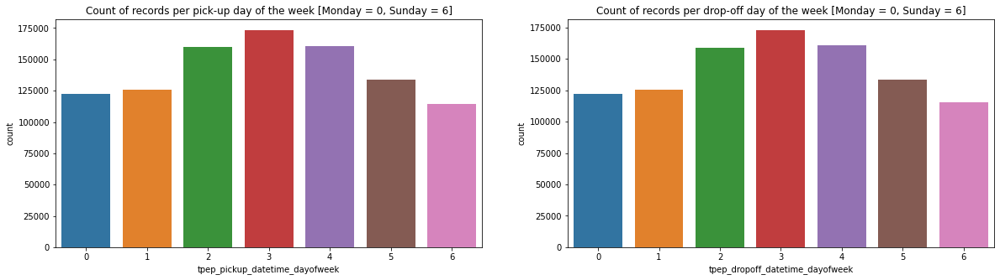

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.countplot(x=nyc_yellow_tripdata_df['tpep_pickup_datetime_dayofweek'],ax=axs[0])
sns.countplot(x=nyc_yellow_tripdata_df['tpep_dropoff_datetime_dayofweek'],ax=axs[1])

axs[0].set_title('Count of records per pick-up day of the week [Monday = 0, Sunday = 6]')
axs[1].set_title('Count of records per drop-off day of the week [Monday = 0, Sunday = 6]')

Most of the trips happen between 6PM and 10PM. There are not many trips at night.

Text(0.5, 1.0, 'Count of records per drop-off hour')

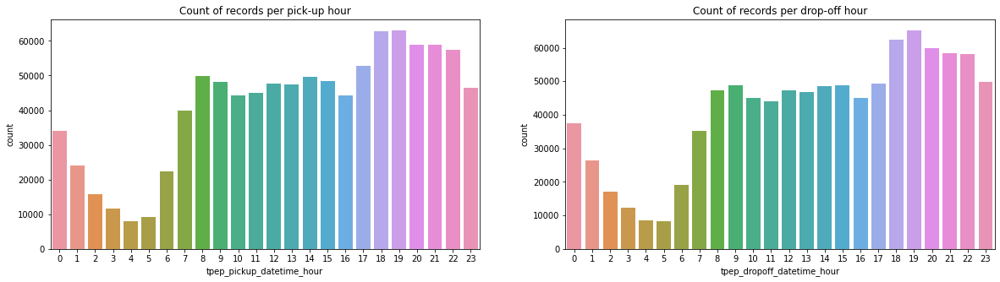

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.countplot(x=nyc_yellow_tripdata_df['tpep_pickup_datetime_hour'],ax=axs[0])
sns.countplot(x=nyc_yellow_tripdata_df['tpep_dropoff_datetime_hour'],ax=axs[1])

axs[0].set_title('Count of records per pick-up hour')
axs[1].set_title('Count of records per drop-off hour')

As it seemed obvious, there are many more trips at night (12PM - 4AM) during the weekends, and many less trips on the morning during the weekends (6AM - 9AM)

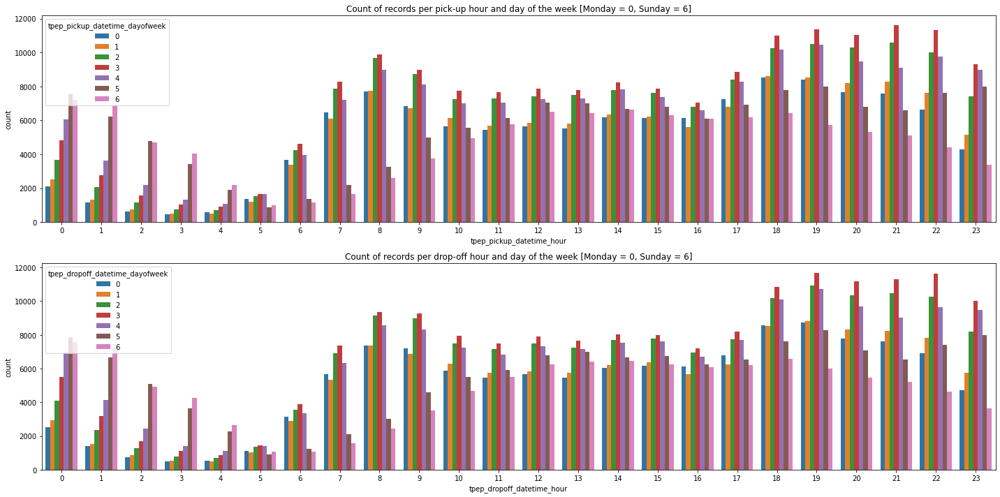

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(20,10))
sns.countplot(data=nyc_yellow_tripdata_df, x='tpep_pickup_datetime_hour',hue='tpep_pickup_datetime_dayofweek',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df, x='tpep_dropoff_datetime_hour',hue='tpep_dropoff_datetime_dayofweek',ax=axs[1])

axs[0].set_title('Count of records per pick-up hour and day of the week [Monday = 0, Sunday = 6]')
axs[1].set_title('Count of records per drop-off hour and day of the week [Monday = 0, Sunday = 6]')

fig.tight_layout()

###passenger_count

Most of the trips are for a single passanger.

Text(0.5, 1.0, 'Count of records per passanger number')

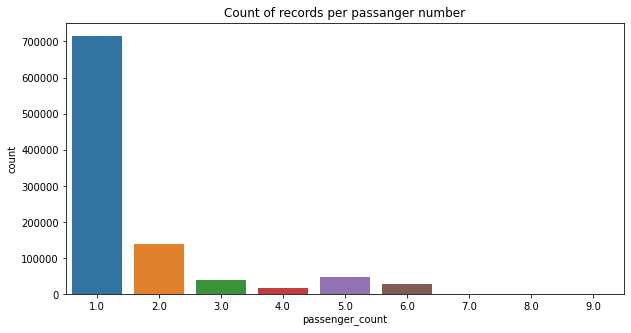

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(10,5))
sns.countplot(x=nyc_yellow_tripdata_df['passenger_count'],ax=ax)

ax.set_title('Count of records per passanger number')

### trip_distance

Most of the trips are below ~5 miles, although this distribution has a positive skew

Text(0.5, 1.0, 'Boxplot of the trip distance')

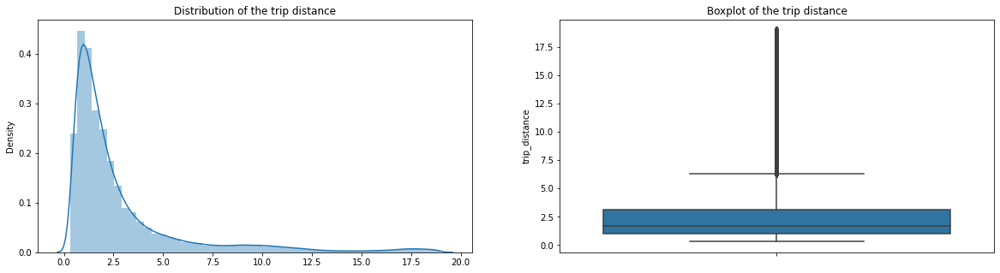

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.distplot(x=nyc_yellow_tripdata_df['trip_distance'],ax=axs[0])
sns.boxplot(y=nyc_yellow_tripdata_df['trip_distance'],ax=axs[1])

axs[0].set_title('Distribution of the trip distance')
axs[1].set_title('Boxplot of the trip distance')

###store_and_fwd_flag

Most of the trips are not a store and forward trip, meaning that the vehicle had connection to the server and could send the trip record at the moment that it was recorded

Text(0.5, 1.0, 'Count of records per store_and_fwd_flag')

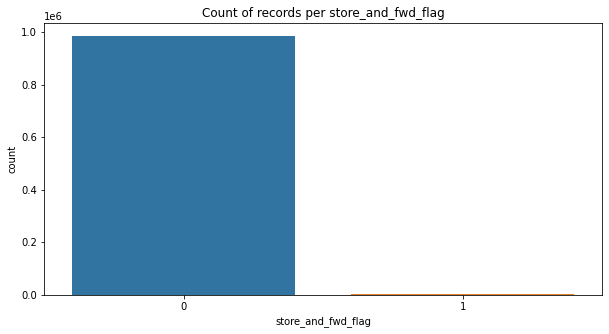

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(10,5))
sns.countplot(x=nyc_yellow_tripdata_df['store_and_fwd_flag'],ax=ax)

ax.set_title('Count of records per store_and_fwd_flag')

###PULocationID and DOLocationID

We use these variables to extract the centroid of the trip pick-up zone and drop-off zone.

In [ ]:
taxi_zones_gpd.head()

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
0,1,0.116357,0.000782,Newark Airport,1,EWR,"POLYGON ((933100.918 192536.086, 933091.011 19..."
1,2,0.433470,0.004866,Jamaica Bay,2,Queens,"MULTIPOLYGON (((1033269.244 172126.008, 103343..."
2,3,0.084341,0.000314,Allerton/Pelham Gardens,3,Bronx,"POLYGON ((1026308.770 256767.698, 1026495.593 ..."
3,4,0.043567,0.000112,Alphabet City,4,Manhattan,"POLYGON ((992073.467 203714.076, 992068.667 20..."
4,5,0.092146,0.000498,Arden Heights,5,Staten Island,"POLYGON ((935843.310 144283.336, 936046.565 14..."


Extract centroids (converted to EPSG:4326, because it is the most common format):

In [ ]:
taxi_zones_gpd['centroid'] = taxi_zones_gpd['geometry'].centroid
taxi_zones_gpd['centroid_x'] = taxi_zones_gpd['centroid'].to_crs('EPSG:4326').x
taxi_zones_gpd['centroid_y'] = taxi_zones_gpd['centroid'].to_crs('EPSG:4326').y

Two of the location IDs appearing in the sample trip dataset are not contained in the taxi zone geometries, so we cannot extract the centroid for those.

In [ ]:
print(set(nyc_yellow_tripdata_df['PULocationID']).difference(set(taxi_zones_gpd['OBJECTID'])))
print(set(nyc_yellow_tripdata_df['DOLocationID']).difference(set(taxi_zones_gpd['OBJECTID'])))

{264, 265}
{264, 265}


In [ ]:
nyc_yellow_tripdata_df = nyc_yellow_tripdata_df.merge(taxi_zones_gpd[['OBJECTID','centroid_x','centroid_y']].rename(columns={'OBJECTID':'PULocationID','centroid_x':'PULocation_centroid_x','centroid_y':'PULocation_centroid_y'}),how='left',on='PULocationID')
nyc_yellow_tripdata_df = nyc_yellow_tripdata_df.merge(taxi_zones_gpd[['OBJECTID','centroid_x','centroid_y']].rename(columns={'OBJECTID':'DOLocationID','centroid_x':'DOLocation_centroid_x','centroid_y':'DOLocation_centroid_y'}),how='left',on='DOLocationID')

In [ ]:
nyc_yellow_tripdata_df[['PULocation_centroid_x','PULocation_centroid_y','DOLocation_centroid_x','DOLocation_centroid_y']].isna().sum()

PULocation_centroid_x    15987
PULocation_centroid_y    15987
DOLocation_centroid_x    15186
DOLocation_centroid_y    15186
dtype: int64

### fare_amount

As we noticed when we reviewed the Pandas Profiling Report, there is a very high peak at a fare amount value of 52 dollars. When searching in Google for "52 dollars NYC taxi", it can be seen that 52 dollars is the amount that is charged for trips between Manhattan and John F. Kennedy Airport (JFK) in either direction: https://www1.nyc.gov/site/tlc/passengers/taxi-fare.page#:~:text=%2452,weekdays%2C%20excluding%20legal%20holidays

This is later reviewed when analyzing records with RatecodeID = JFK

Text(0.5, 1.0, 'Boxplot of the fare amount')

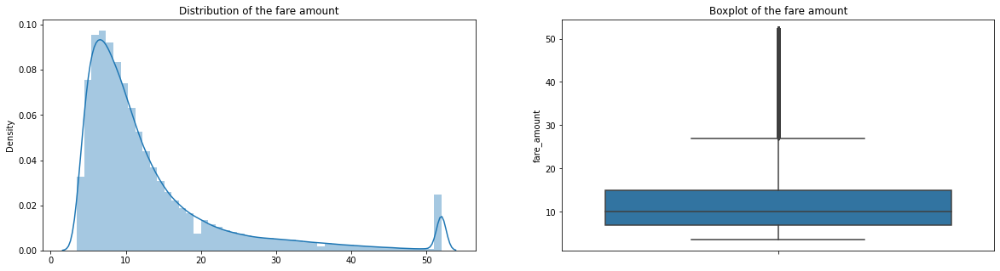

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.distplot(x=nyc_yellow_tripdata_df['fare_amount'],ax=axs[0])
sns.boxplot(y=nyc_yellow_tripdata_df['fare_amount'],ax=axs[1])

axs[0].set_title('Distribution of the fare amount')
axs[1].set_title('Boxplot of the fare amount')

### extra

As indicated in the data dictionary, this only includes
the 0.50 dollar and 1 dollar rush hour and overnight charges after the cleaning

Text(0.5, 1.0, 'Boxplot of the extra charges')

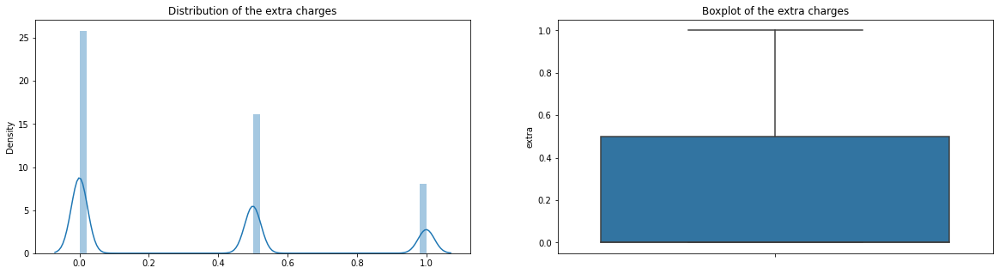

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.distplot(x=nyc_yellow_tripdata_df['extra'],ax=axs[0])
sns.boxplot(y=nyc_yellow_tripdata_df['extra'],ax=axs[1])

axs[0].set_title('Distribution of the extra charges')
axs[1].set_title('Boxplot of the extra charges')

### mta_tax

As indicated in the data dictionary, this is a 0.50 dollar MTA tax that is automatically triggered based on the metered rate in use.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:316: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  warnings.warn(msg, UserWarning)


Text(0.5, 1.0, 'Boxplot of the MTA tax')

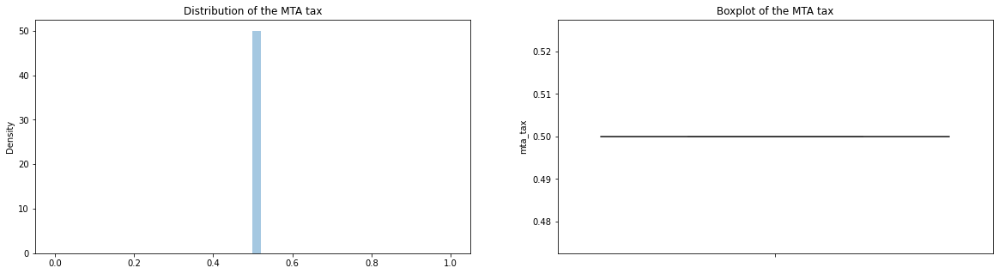

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.distplot(x=nyc_yellow_tripdata_df['mta_tax'],ax=axs[0])
sns.boxplot(y=nyc_yellow_tripdata_df['mta_tax'],ax=axs[1])

axs[0].set_title('Distribution of the MTA tax')
axs[1].set_title('Boxplot of the MTA tax')

### [TARGET!] tip_amount

There are obvious peaks at 0, 1, 1.5, 2 and 3 dollars. The value rarely exceeds 5 dollars

Text(0.5, 1.0, 'Boxplot of the tip amount')

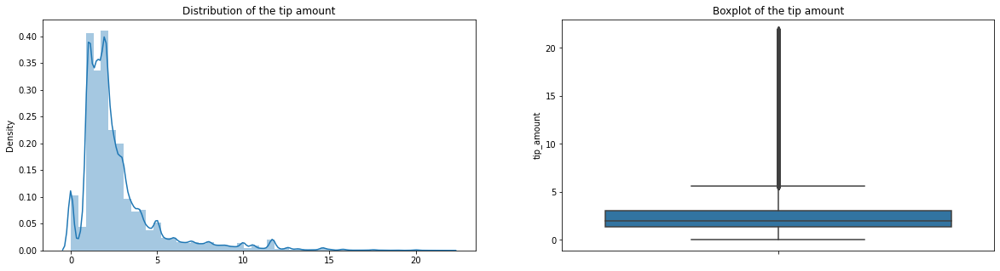

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.distplot(x=nyc_yellow_tripdata_df['tip_amount'],ax=axs[0])
sns.boxplot(y=nyc_yellow_tripdata_df['tip_amount'],ax=axs[1])

axs[0].set_title('Distribution of the tip amount')
axs[1].set_title('Boxplot of the tip amount')

In [ ]:
nyc_yellow_tripdata_df['tip_amount'].value_counts().head(10)

1.00    88883
2.00    46727
0.00    41227
1.50    19009
3.00    15330
1.66    13858
1.56    13789
1.46    13709
1.95    13662
1.36    13257
Name: tip_amount, dtype: int64

### tolls_amount

There are high peaks at 0, 5.76 and 5.54 dollars.

Text(0.5, 1.0, 'Boxplot of the tolls amount')

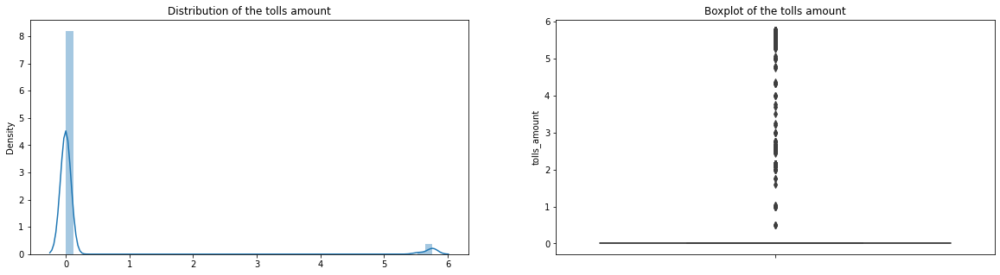

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.distplot(x=nyc_yellow_tripdata_df['tolls_amount'],ax=axs[0])
sns.boxplot(y=nyc_yellow_tripdata_df['tolls_amount'],ax=axs[1])

axs[0].set_title('Distribution of the tolls amount')
axs[1].set_title('Boxplot of the tolls amount')

In [ ]:
nyc_yellow_tripdata_df['tolls_amount'].value_counts().head(10)

0.00    930567
5.76     43372
5.54     11675
2.64       400
2.54       126
5.75        37
2.16        28
5.74        12
5.00        11
5.50         9
Name: tolls_amount, dtype: int64

### improvement_surcharge

As indicated in the data dictionary, there is a 0.30 dollar improvement surcharge assessed trips at the flag drop. The
improvement surcharge began being levied in 2015.

Text(0.5, 1.0, 'Boxplot of the improvement surcharge')

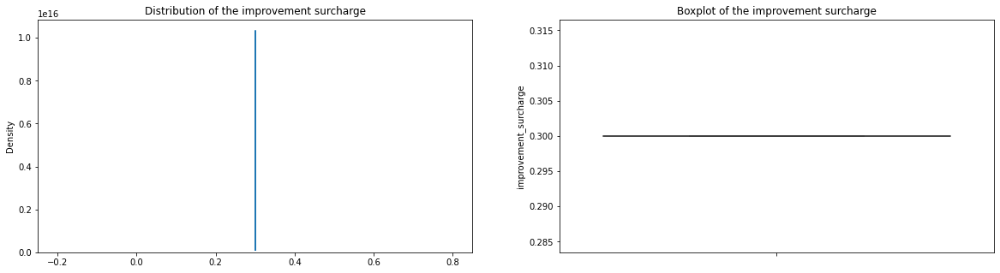

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.distplot(x=nyc_yellow_tripdata_df['improvement_surcharge'],ax=axs[0])
sns.boxplot(y=nyc_yellow_tripdata_df['improvement_surcharge'],ax=axs[1])

axs[0].set_title('Distribution of the improvement surcharge')
axs[1].set_title('Boxplot of the improvement surcharge')

### total_amount

The total amount rarely exceeds ~35 dollars. The peak at 70.27 dollars generally matches the peak at 52 dollars for the fare amount (i.e., probably trips between Manhattan and John F. Kennedy Airport in either direction)

https://www1.nyc.gov/site/tlc/passengers/taxi-fare.page#:~:text=%2452,weekdays%2C%20excluding%20legal%20holidays

This is later reviewed when analyzing records with RatecodeID = JFK

Text(0.5, 1.0, 'Boxplot of the total trip amount')

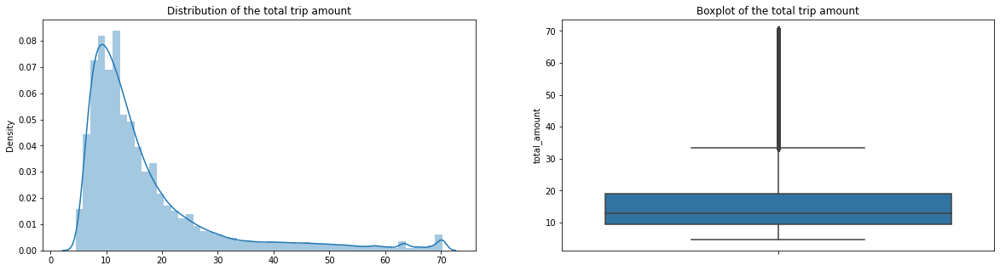

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.distplot(x=nyc_yellow_tripdata_df['total_amount'],ax=axs[0])
sns.boxplot(y=nyc_yellow_tripdata_df['total_amount'],ax=axs[1])

axs[0].set_title('Distribution of the total trip amount')
axs[1].set_title('Boxplot of the total trip amount')

In [ ]:
nyc_yellow_tripdata_df[nyc_yellow_tripdata_df['total_amount']==np.max(nyc_yellow_tripdata_df['total_amount'])].groupby(by=['total_amount','fare_amount'])['total_amount'].count()

total_amount  fare_amount
70.27         51.0              5
              51.5              4
              52.0           3446
Name: total_amount, dtype: int64

### meter_engagement_time_minutes

The trips are rarely over ~40 minutes long.

Text(0.5, 1.0, 'Boxplot of the meter engagement time')

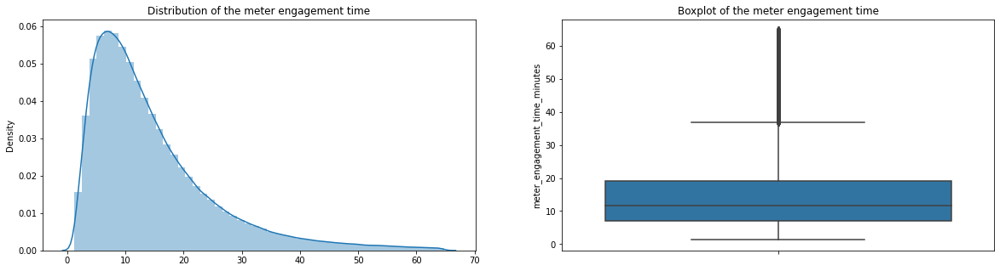

In [ ]:
fig,axs = plt.subplots(1,2,figsize=(20,5))
sns.distplot(x=nyc_yellow_tripdata_df['meter_engagement_time_minutes'],ax=axs[0])
sns.boxplot(y=nyc_yellow_tripdata_df['meter_engagement_time_minutes'],ax=axs[1])

axs[0].set_title('Distribution of the meter engagement time')
axs[1].set_title('Boxplot of the meter engagement time')

### RatecodeID

Most of the trips have a standard rate, or a JKF rate (airport)

Text(0.5, 1.0, 'Count of records per RatecodeID')

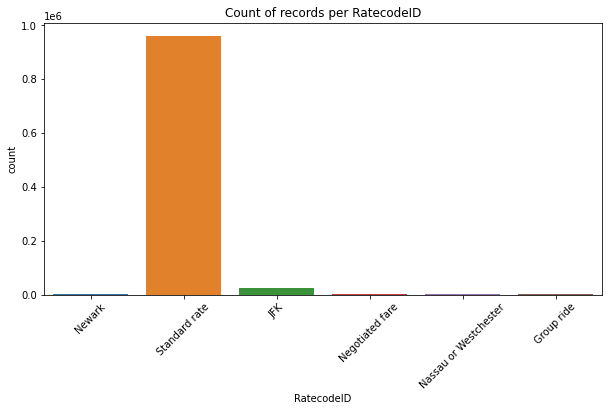

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(10,5))
sns.countplot(x=nyc_yellow_tripdata_df['RatecodeID'],ax=ax)
plt.xticks(rotation = 45)

ax.set_title('Count of records per RatecodeID')

As we were suspecting before, the JFK (airport) rate corresponds to the 52 dollar fare amount, and the records with the peaks at the maximum total amount

In [ ]:
nyc_yellow_tripdata_df[nyc_yellow_tripdata_df['RatecodeID']=='JFK'].groupby(by=['fare_amount','total_amount'])['RatecodeID'].count().reset_index().rename(columns={'RatecodeID':'count'}).sort_values(by='count', ascending=False)

,fare_amount,total_amount,count
331,52.0,70.27,3426
330,52.0,70.26,1943
144,52.0,63.36,1504
320,52.0,70.01,1043
143,52.0,63.35,884
...,...,...,...
80,52.0,60.19,1
209,52.0,65.93,1
79,52.0,60.16,1
213,52.0,66.10,1


### payment_type

As indicated in the cleaning notebook and the beginning of this notebook, we made the decision to only keep records with credit card payments, because it seems that it is the only payment option for which the tip amount is being automatically recorded

Text(0.5, 1.0, 'Count of records per payment type')

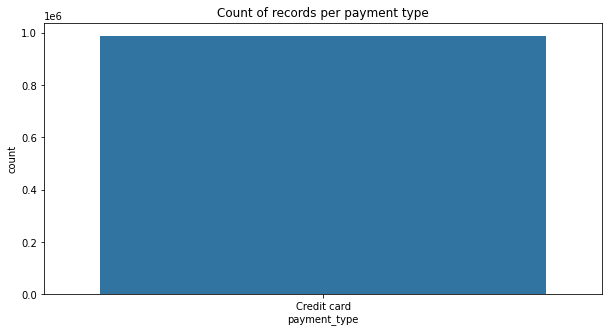

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(10,5))
sns.countplot(x=nyc_yellow_tripdata_df['payment_type'],ax=ax)
ax.set_title('Count of records per payment type')

### VendorID

As indicated in the data dictionary, there are two vendors for the  TPEP provider that provided the record. The record count per vendor is similar.

Text(0.5, 1.0, 'Count of records per TPEP provider')

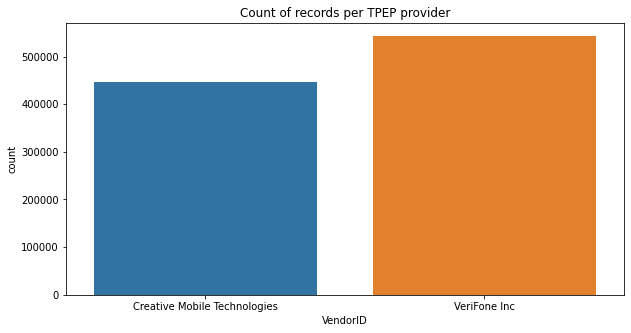

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(10,5))
sns.countplot(x=nyc_yellow_tripdata_df['VendorID'],ax=ax)
ax.set_title('Count of records per TPEP provider')

## Bivariate analysis (vs target)

In [ ]:
nyc_yellow_tripdata_df.columns

Index(['tpep_pickup_datetime', 'tpep_dropoff_datetime', 'passenger_count',
       'trip_distance', 'store_and_fwd_flag', 'PULocationID', 'DOLocationID',
       'fare_amount', 'extra', 'mta_tax', 'tip_amount', 'tolls_amount',
       'improvement_surcharge', 'total_amount',
       'meter_engagement_time_minutes', 'RatecodeID', 'payment_type',
       'VendorID', 'tpep_pickup_datetime_dayofweek',
       'tpep_dropoff_datetime_dayofweek', 'tpep_pickup_datetime_hour',
       'tpep_dropoff_datetime_hour', 'PULocation_centroid_x',
       'PULocation_centroid_y', 'DOLocation_centroid_x',
       'DOLocation_centroid_y'],
      dtype='object')

###tpep_pickup_datetime and tpep_dropoff_datetime

The day of the week does not seem to have a high influence on the tip amount

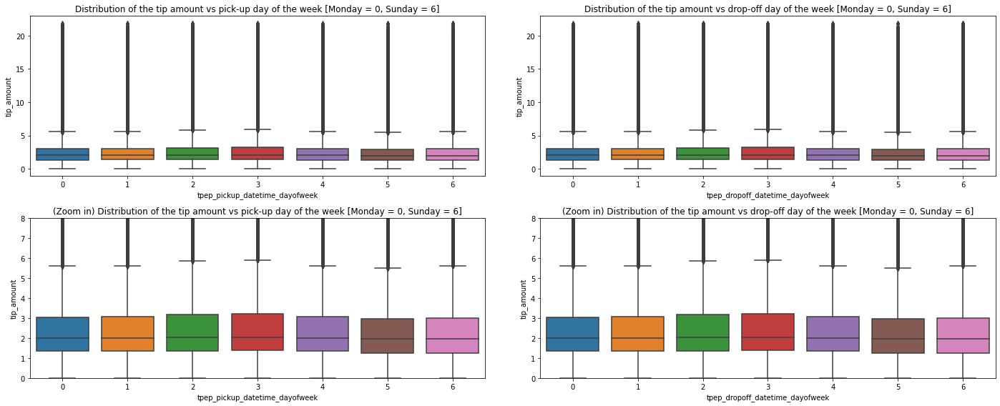

In [ ]:
fig,axs = plt.subplots(2,2,figsize=(20,8))
axs = axs.ravel()
sns.boxplot(data=nyc_yellow_tripdata_df,x='tpep_pickup_datetime_dayofweek',y='tip_amount',ax=axs[0])
sns.boxplot(data=nyc_yellow_tripdata_df,x='tpep_dropoff_datetime_dayofweek',y='tip_amount',ax=axs[1])

sns.boxplot(data=nyc_yellow_tripdata_df,x='tpep_pickup_datetime_dayofweek',y='tip_amount',ax=axs[2])
sns.boxplot(data=nyc_yellow_tripdata_df,x='tpep_dropoff_datetime_dayofweek',y='tip_amount',ax=axs[3])

axs[2].set_ylim(0,8)
axs[3].set_ylim(0,8)

axs[0].set_title('Distribution of the tip amount vs pick-up day of the week [Monday = 0, Sunday = 6]')
axs[1].set_title('Distribution of the tip amount vs drop-off day of the week [Monday = 0, Sunday = 6]')

axs[2].set_title("(Zoom in) Distribution of the tip amount vs pick-up day of the week [Monday = 0, Sunday = 6]")
axs[3].set_title("(Zoom in) Distribution of the tip amount vs drop-off day of the week [Monday = 0, Sunday = 6]")


fig.tight_layout()

Tips at night (especially at 4AM-5AM) seem higher, but there many less records at these hours, so we cannot be as sure about this trend as we can be for other hours in which we have a much higher number of records.

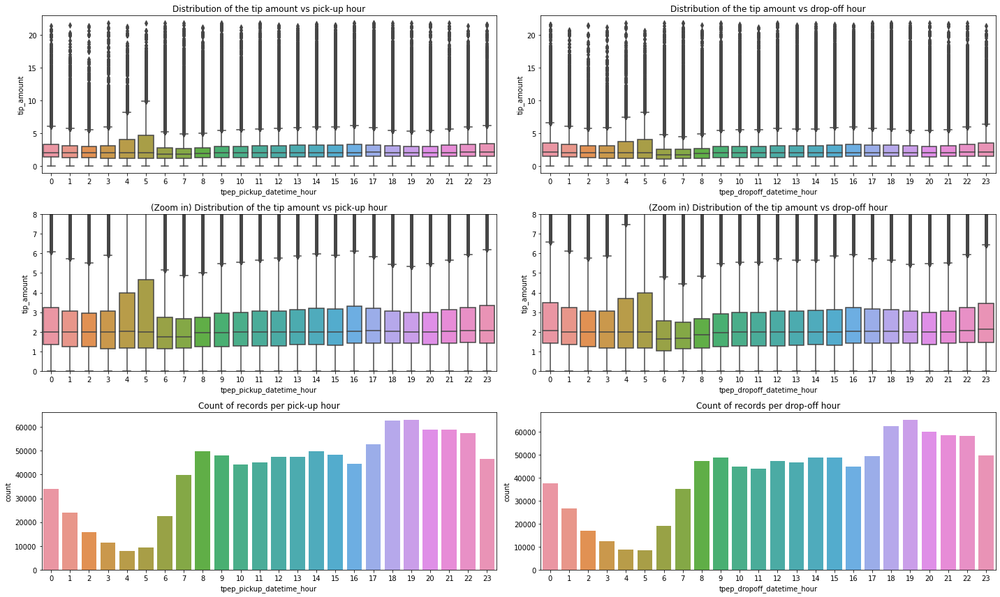

In [ ]:
fig,axs = plt.subplots(3,2,figsize=(20,12))
axs = axs.ravel()
sns.boxplot(data=nyc_yellow_tripdata_df,x='tpep_pickup_datetime_hour',y='tip_amount',ax=axs[0])
sns.boxplot(data=nyc_yellow_tripdata_df,x='tpep_dropoff_datetime_hour',y='tip_amount',ax=axs[1])

sns.boxplot(data=nyc_yellow_tripdata_df,x='tpep_pickup_datetime_hour',y='tip_amount',ax=axs[2])
sns.boxplot(data=nyc_yellow_tripdata_df,x='tpep_dropoff_datetime_hour',y='tip_amount',ax=axs[3])

sns.countplot(x=nyc_yellow_tripdata_df['tpep_pickup_datetime_hour'],ax=axs[4])
sns.countplot(x=nyc_yellow_tripdata_df['tpep_dropoff_datetime_hour'],ax=axs[5])

axs[0].set_title('Distribution of the tip amount vs pick-up hour')
axs[1].set_title('Distribution of the tip amount vs drop-off hour')

axs[2].set_title("(Zoom in) Distribution of the tip amount vs pick-up hour")
axs[3].set_title("(Zoom in) Distribution of the tip amount vs drop-off hour")

axs[4].set_title("Count of records per pick-up hour")
axs[5].set_title("Count of records per drop-off hour")

axs[2].set_ylim(0,8)
axs[3].set_ylim(0,8)

fig.tight_layout()

Monday = 0, Sunday = 6.
Whenever there are a large number of samples for a combination of day + hour, there does not seem to be a clear tendency that is mantained over a few hours for the same day. Therefore, according to this figure and the previous ones, probably it is not necessary to include these variables as input for the model.

*Note: for simplicity, we only draw this figure for pick-up times, as we can already observe in the previous plots that the tendencies for pick-up and drop-off times are practically the same

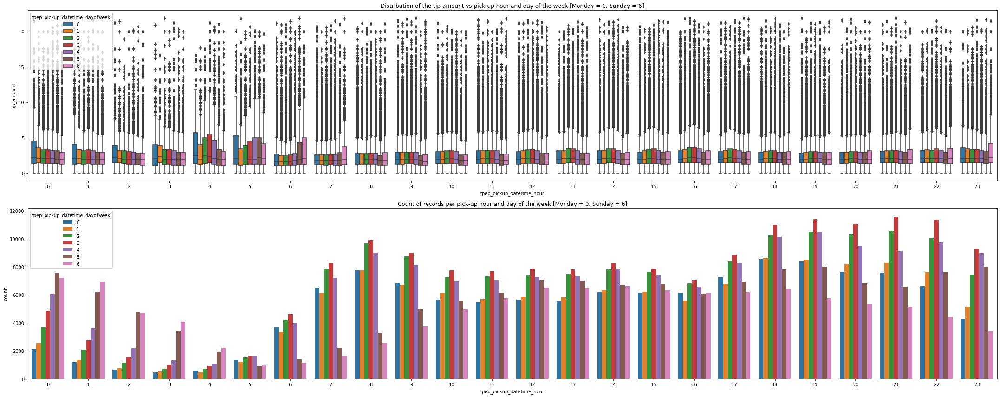

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(30,12))
axs = axs.ravel()
sns.boxplot(data=nyc_yellow_tripdata_df,x='tpep_pickup_datetime_hour',hue='tpep_pickup_datetime_dayofweek',y='tip_amount',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df,x='tpep_pickup_datetime_hour',hue='tpep_pickup_datetime_dayofweek',ax=axs[1])

axs[0].set_title('Distribution of the tip amount vs pick-up hour and day of the week [Monday = 0, Sunday = 6]')
axs[1].set_title('Count of records per pick-up hour and day of the week [Monday = 0, Sunday = 6]')

fig.tight_layout()

###passenger_count

There does not seem to be a big difference in the tip amount that is given according to the number of passengers (we can ignore the tip amount box plots for passengers >=7, since there are too few records to draw conclusions from them)

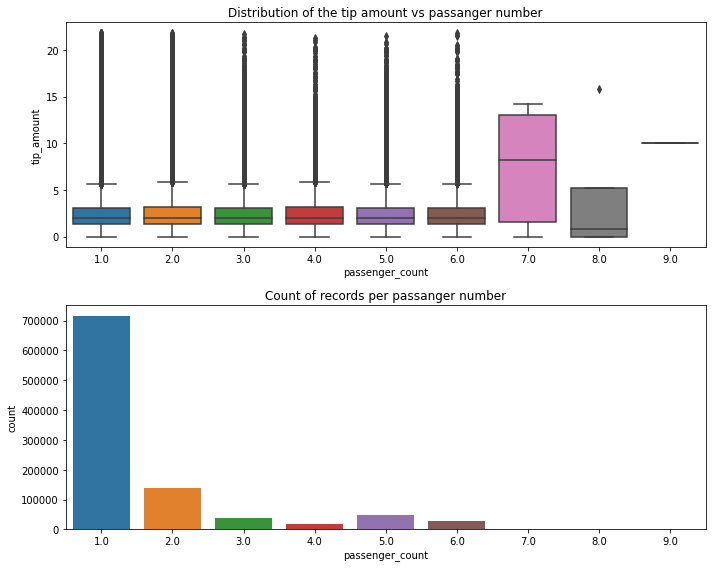

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(10,8))

sns.boxplot(data=nyc_yellow_tripdata_df,x='passenger_count',y='tip_amount',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df,x='passenger_count',ax=axs[1])

axs[0].set_title('Distribution of the tip amount vs passenger number')
axs[1].set_title('Count of records per passenger number')

fig.tight_layout()

###trip_distance

The tip amount clearly increases with the trip distance

In [ ]:
nyc_yellow_tripdata_df_plot = nyc_yellow_tripdata_df.copy()
nyc_yellow_tripdata_df_plot['trip_distance_bin'] = pd.cut(nyc_yellow_tripdata_df_plot['trip_distance'].dropna(),bins=30).astype(str)
nyc_yellow_tripdata_df_plot['trip_distance_bin_left'] = nyc_yellow_tripdata_df_plot['trip_distance_bin'].str.extract(r'\((.*),',expand=True).astype(float)

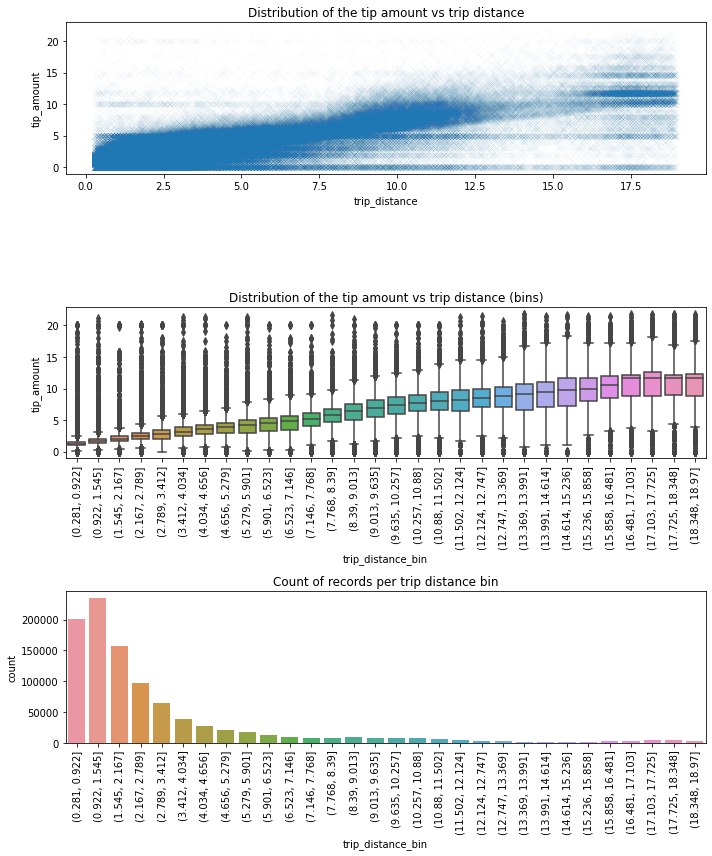

In [ ]:
fig,axs = plt.subplots(3,1,figsize=(10,12))

sns.scatterplot(data=nyc_yellow_tripdata_df_plot,x='trip_distance',y='tip_amount',alpha=0.03,marker='x',ax=axs[0])
sns.boxplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='trip_distance_bin_left'),x='trip_distance_bin',y='tip_amount',ax=axs[1])
sns.countplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='trip_distance_bin_left'),x='trip_distance_bin',ax=axs[2])

for tick in axs[1].get_xticklabels():
  tick.set_rotation(90)
for tick in axs[2].get_xticklabels():
  tick.set_rotation(90)

axs[0].set_title('Distribution of the tip amount vs trip distance')
axs[1].set_title('Distribution of the tip amount vs trip distance (bins)')
axs[2].set_title('Count of records per trip distance bin')


fig.tight_layout()

###store_and_fwd_flag

This variable is not relevant for the model, since there are too few records with store_and_fwd_flag = 1 to draw strong conclusions from it

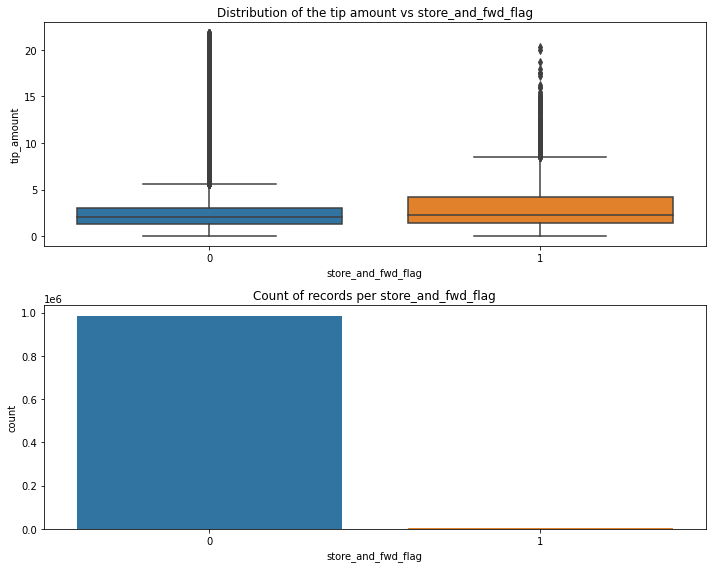

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(10,8))

sns.boxplot(data=nyc_yellow_tripdata_df,x='store_and_fwd_flag',y='tip_amount',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df,x='store_and_fwd_flag',ax=axs[1])

axs[0].set_title('Distribution of the tip amount vs store_and_fwd_flag')
axs[1].set_title('Count of records per store_and_fwd_flag')

fig.tight_layout()

In [ ]:
nyc_yellow_tripdata_df['store_and_fwd_flag'].value_counts()

0    985911
1      3922
Name: store_and_fwd_flag, dtype: int64

###PULocationID and DOLocationID

There is a clear relationship between the pick-up and drop-off location and the mean tip amount (as we already noticed at the beginning of this notebook)

In [ ]:
nyc_yellow_tripdata_df_plot = nyc_yellow_tripdata_df[['PULocationID','PULocation_centroid_x','PULocation_centroid_y','tip_amount']]
nyc_yellow_tripdata_df_plot = nyc_yellow_tripdata_df_plot.groupby(by=['PULocationID','PULocation_centroid_x','PULocation_centroid_y'])['tip_amount'].mean().reset_index()
nyc_yellow_tripdata_gdf_plot = gpd.GeoDataFrame(nyc_yellow_tripdata_df_plot,geometry=gpd.points_from_xy(nyc_yellow_tripdata_df_plot.PULocation_centroid_x, nyc_yellow_tripdata_df_plot.PULocation_centroid_y))

This map represents the mean tip amount per pick-up location

In [ ]:
Layer(nyc_yellow_tripdata_gdf_plot,
      color_bins_style('tip_amount', palette='pinkyl', bins=10, opacity=0.8),
      popup_hover=[
        popup_element('tip_amount','Mean tip amount (dollars)'),
    ]
)

In [ ]:
nyc_yellow_tripdata_df_plot = nyc_yellow_tripdata_df[['DOLocationID','DOLocation_centroid_x','DOLocation_centroid_y','tip_amount']]
nyc_yellow_tripdata_df_plot = nyc_yellow_tripdata_df_plot.groupby(by=['DOLocationID','DOLocation_centroid_x','DOLocation_centroid_y'])['tip_amount'].mean().reset_index()
nyc_yellow_tripdata_gdf_plot = gpd.GeoDataFrame(nyc_yellow_tripdata_df_plot, 
                                                geometry=gpd.points_from_xy(nyc_yellow_tripdata_df_plot.DOLocation_centroid_x, nyc_yellow_tripdata_df_plot.DOLocation_centroid_y))

This map represents the mean tip amount per drop-off location

In [ ]:
Layer(nyc_yellow_tripdata_gdf_plot,
      color_bins_style('tip_amount', palette='pinkyl', bins=10, opacity=0.8),
      popup_hover=[
        popup_element('tip_amount','Mean tip amount (dollars)'),
    ]
)

###fare_amount

The tip amount clearly increases with the fare amount

In [ ]:
nyc_yellow_tripdata_df_plot = nyc_yellow_tripdata_df.copy()
nyc_yellow_tripdata_df_plot['fare_amount_bin'] = pd.cut(nyc_yellow_tripdata_df_plot['fare_amount'].dropna(),bins=30).astype(str)
nyc_yellow_tripdata_df_plot['fare_amount_bin_left'] = nyc_yellow_tripdata_df_plot['fare_amount_bin'].str.extract(r'\((.*),',expand=True).astype(float)

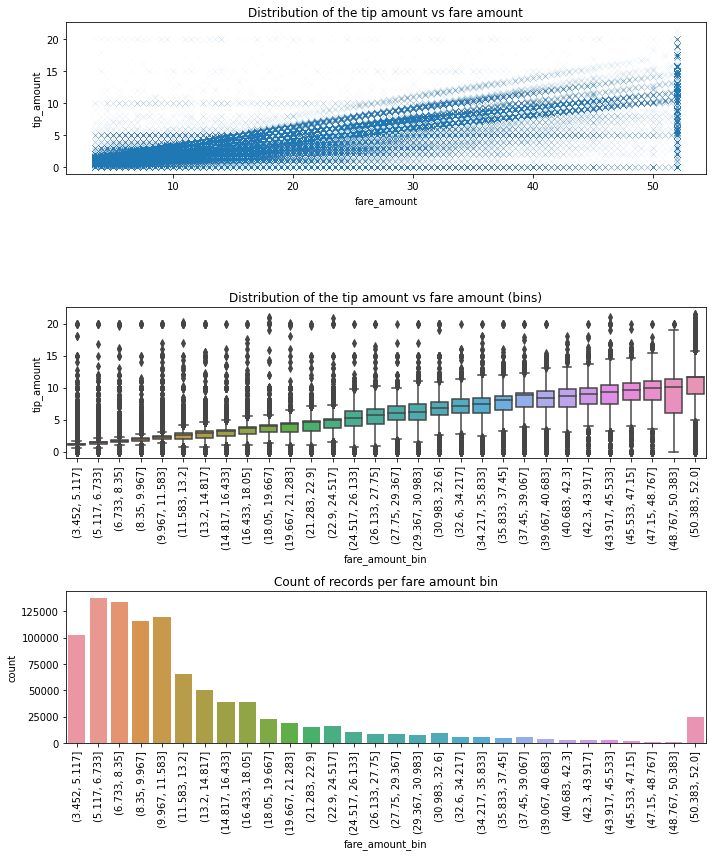

In [ ]:
fig,axs = plt.subplots(3,1,figsize=(10,12))

sns.scatterplot(data=nyc_yellow_tripdata_df_plot,x='fare_amount',y='tip_amount',alpha=0.03,marker='x',ax=axs[0])
sns.boxplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='fare_amount_bin_left'),x='fare_amount_bin',y='tip_amount',ax=axs[1])
sns.countplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='fare_amount_bin_left'),x='fare_amount_bin',ax=axs[2])

for tick in axs[1].get_xticklabels():
  tick.set_rotation(90)
for tick in axs[2].get_xticklabels():
  tick.set_rotation(90)

axs[0].set_title('Distribution of the tip amount vs fare amount')
axs[1].set_title('Distribution of the tip amount vs fare amount (bins)')
axs[2].set_title('Count of records per fare amount bin')

fig.tight_layout()

###extra

The miscellaneous extras and surcharges do not seem to have a noticeable effect on the tip amount.

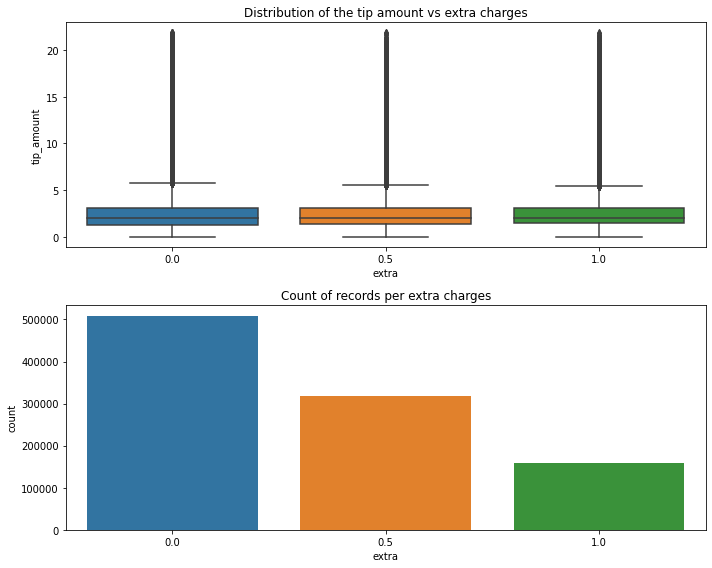

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(10,8))

sns.boxplot(data=nyc_yellow_tripdata_df,x='extra',y='tip_amount',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df,x='extra',ax=axs[1])

axs[0].set_title('Distribution of the tip amount vs extra charges')
axs[1].set_title('Count of records per extra charges')

fig.tight_layout()

###mta_tax

Since there is only one value for this variable, it is useless to include it in the machine learning model.

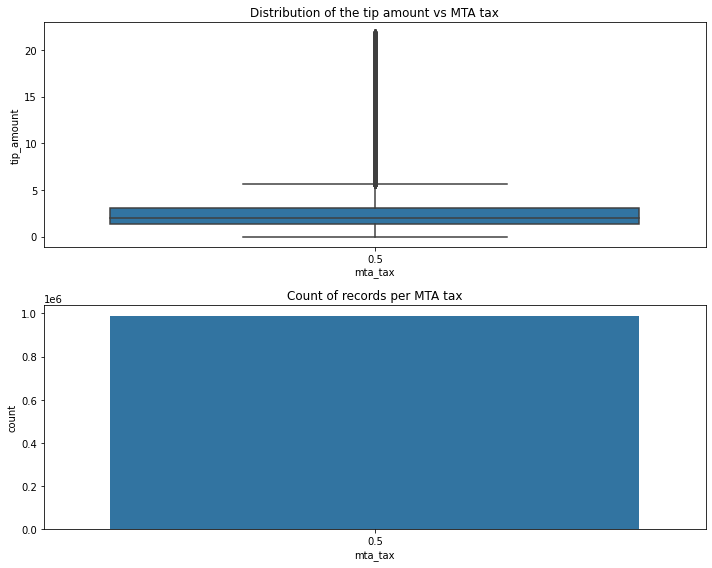

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(10,8))

sns.boxplot(data=nyc_yellow_tripdata_df,x='mta_tax',y='tip_amount',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df,x='mta_tax',ax=axs[1])

axs[0].set_title('Distribution of the tip amount vs MTA tax')
axs[1].set_title('Count of records per MTA tax')

fig.tight_layout()

###tolls_amount

The majority of the values of this distribution gather around the minimum and the maximum. When the toll amount is around the maximum value, the tip amount seems to be higher than when there is no toll.

In [ ]:
nyc_yellow_tripdata_df_plot = nyc_yellow_tripdata_df.copy()
nyc_yellow_tripdata_df_plot['tolls_amount_bin'] = pd.cut(nyc_yellow_tripdata_df_plot['tolls_amount'].dropna(),bins=30).astype(str)
nyc_yellow_tripdata_df_plot['tolls_amount_bin_left'] = nyc_yellow_tripdata_df_plot['tolls_amount_bin'].str.extract(r'\((.*),',expand=True).astype(float)

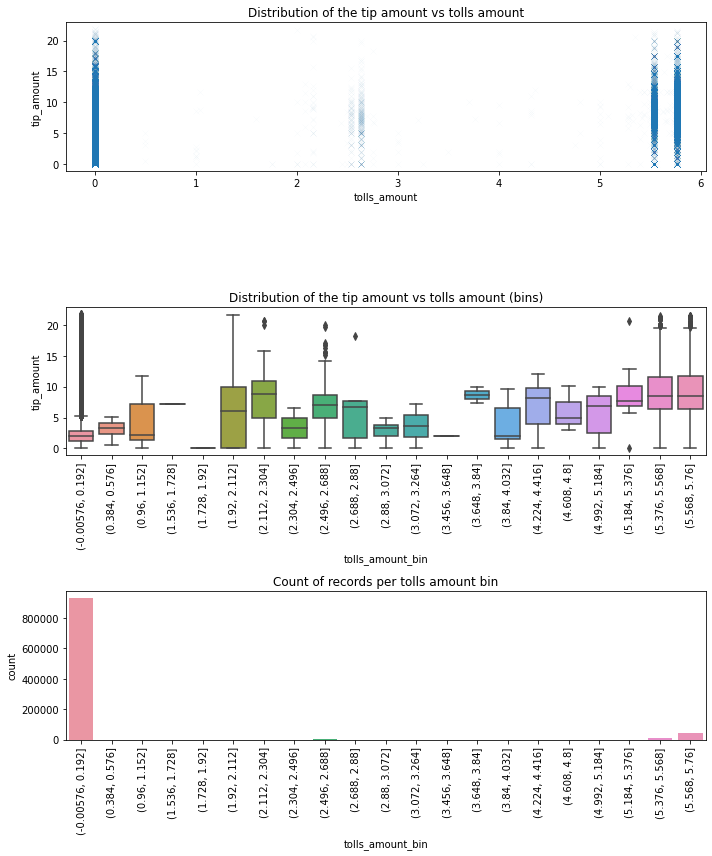

In [ ]:
fig,axs = plt.subplots(3,1,figsize=(10,12))

sns.scatterplot(data=nyc_yellow_tripdata_df_plot,x='tolls_amount',y='tip_amount',alpha=0.03,marker='x',ax=axs[0])
sns.boxplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='tolls_amount_bin_left'),x='tolls_amount_bin',y='tip_amount',ax=axs[1])
sns.countplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='tolls_amount_bin_left'),x='tolls_amount_bin',ax=axs[2])

for tick in axs[1].get_xticklabels():
  tick.set_rotation(90)
for tick in axs[2].get_xticklabels():
  tick.set_rotation(90)

axs[0].set_title('Distribution of the tip amount vs tolls amount')
axs[1].set_title('Distribution of the tip amount vs tolls amount (bins)')
axs[2].set_title('Count of records per tolls amount bin')

fig.tight_layout()

###improvement_surcharge

Since there is only one value for this variable, it is useless to include it in the machine learning model.

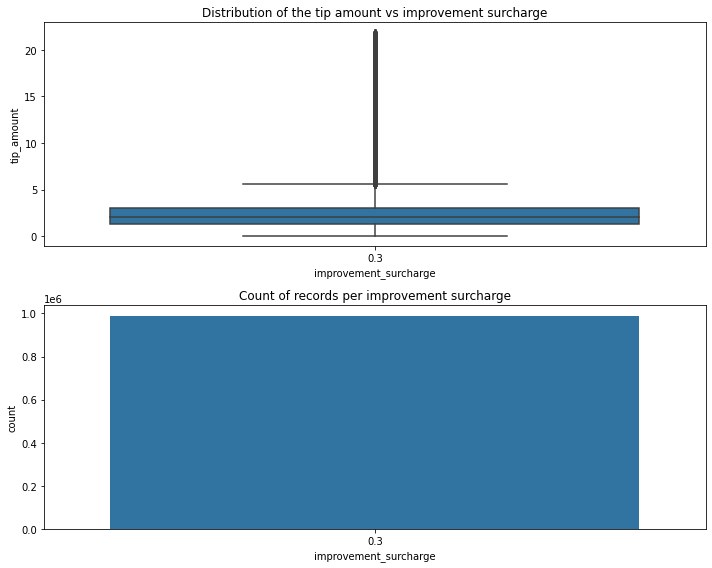

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(10,8))

sns.boxplot(data=nyc_yellow_tripdata_df,x='improvement_surcharge',y='tip_amount',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df,x='improvement_surcharge',ax=axs[1])

axs[0].set_title('Distribution of the tip amount vs improvement surcharge')
axs[1].set_title('Count of records per improvement surcharge')

fig.tight_layout()

###total_amount

The tip amount clearly increases with the total amount charged to the passengers

In [ ]:
nyc_yellow_tripdata_df_plot = nyc_yellow_tripdata_df.copy()
nyc_yellow_tripdata_df_plot['total_amount_bin'] = pd.cut(nyc_yellow_tripdata_df_plot['total_amount'].dropna(),bins=30).astype(str)
nyc_yellow_tripdata_df_plot['total_amount_bin_left'] = nyc_yellow_tripdata_df_plot['total_amount_bin'].str.extract(r'\((.*),',expand=True).astype(float)

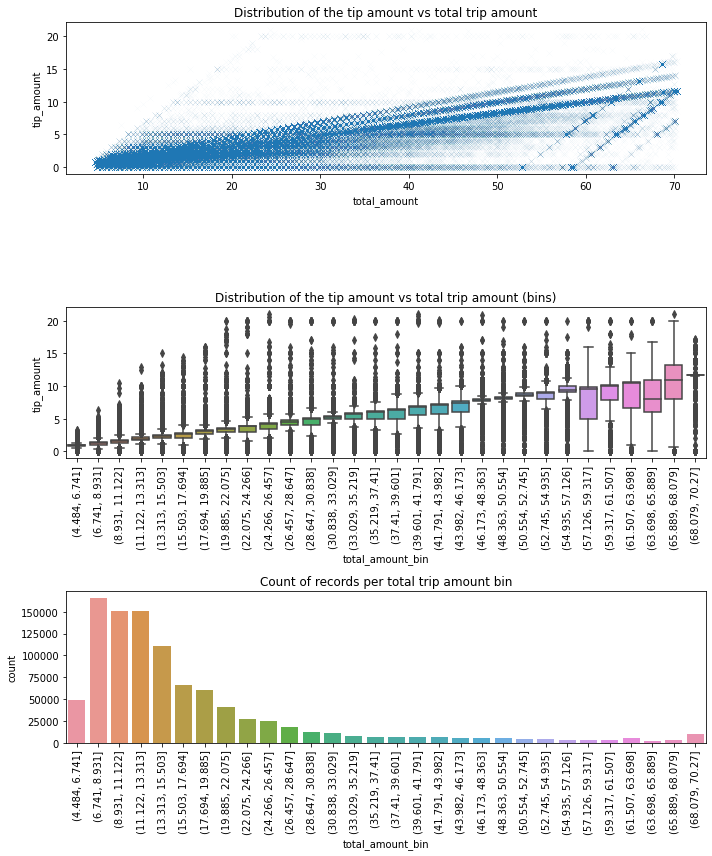

In [ ]:
fig,axs = plt.subplots(3,1,figsize=(10,12))

sns.scatterplot(data=nyc_yellow_tripdata_df_plot,x='total_amount',y='tip_amount',alpha=0.03,marker='x',ax=axs[0])
sns.boxplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='total_amount_bin_left'),x='total_amount_bin',y='tip_amount',ax=axs[1])
sns.countplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='total_amount_bin_left'),x='total_amount_bin',ax=axs[2])

for tick in axs[1].get_xticklabels():
  tick.set_rotation(90)
for tick in axs[2].get_xticklabels():
  tick.set_rotation(90)

axs[0].set_title('Distribution of the tip amount vs total trip amount')
axs[1].set_title('Distribution of the tip amount vs total trip amount (bins)')
axs[2].set_title('Count of records per total trip amount bin')

fig.tight_layout()

###meter_engagement_time_minutes

The tip amount clearly increases with the trip duration

In [ ]:
nyc_yellow_tripdata_df_plot = nyc_yellow_tripdata_df.copy()
nyc_yellow_tripdata_df_plot['meter_engagement_time_minutes_bin'] = pd.cut(nyc_yellow_tripdata_df_plot['meter_engagement_time_minutes'].dropna(),bins=30).astype(str)
nyc_yellow_tripdata_df_plot['meter_engagement_time_minutes_bin_left'] = nyc_yellow_tripdata_df_plot['meter_engagement_time_minutes_bin'].str.extract(r'\((.*),',expand=True).astype(float)

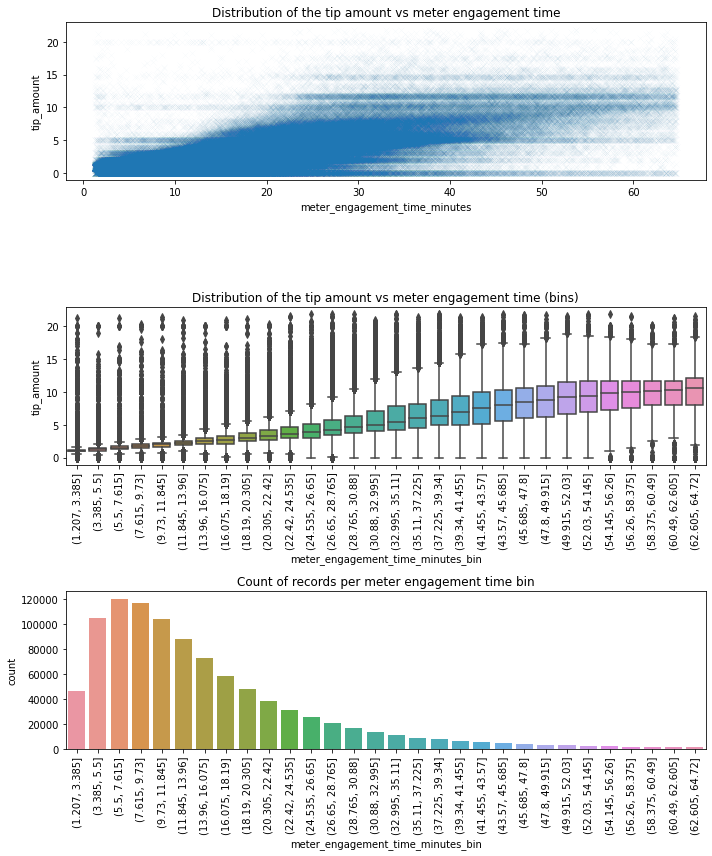

In [ ]:
fig,axs = plt.subplots(3,1,figsize=(10,12))

sns.scatterplot(data=nyc_yellow_tripdata_df_plot,x='meter_engagement_time_minutes',y='tip_amount',alpha=0.03,marker='x',ax=axs[0])
sns.boxplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='meter_engagement_time_minutes_bin_left'),x='meter_engagement_time_minutes_bin',y='tip_amount',ax=axs[1])
sns.countplot(data=nyc_yellow_tripdata_df_plot.sort_values(by='meter_engagement_time_minutes_bin_left'),x='meter_engagement_time_minutes_bin',ax=axs[2])

for tick in axs[1].get_xticklabels():
  tick.set_rotation(90)
for tick in axs[2].get_xticklabels():
  tick.set_rotation(90)

axs[0].set_title('Distribution of the tip amount vs meter engagement time')
axs[1].set_title('Distribution of the tip amount vs meter engagement time (bins)')
axs[2].set_title('Count of records per meter engagement time bin')

fig.tight_layout()

###RatecodeID

Almost all of the trips have a standard rate, so probably this variable will not add much to the machine learning model. Nevertheless, the tip amount seems higher in the case of JFK trips or Newark trips, so we could try to include it

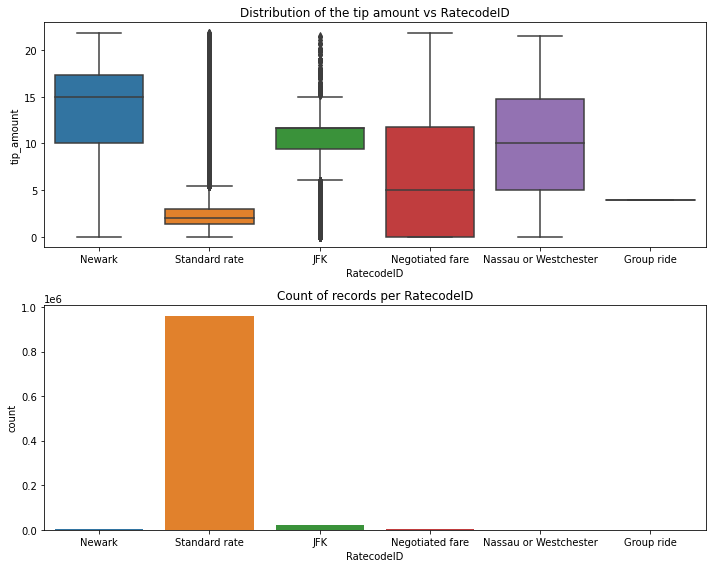

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(10,8))

sns.boxplot(data=nyc_yellow_tripdata_df,x='RatecodeID',y='tip_amount',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df,x='RatecodeID',ax=axs[1])

axs[0].set_title('Distribution of the tip amount vs RatecodeID')
axs[1].set_title('Count of records per RatecodeID')

fig.tight_layout()

###payment_type

As already explained, we only included credit card payments, since those seem to be the only ones for which the tip amount is being properly collected. Therefore, it is useless to include this variable in the machine learning model.

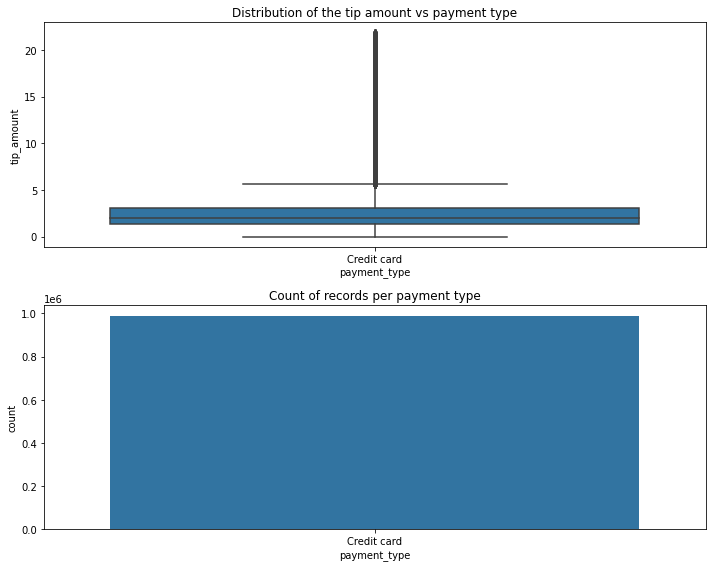

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(10,8))

sns.boxplot(data=nyc_yellow_tripdata_df,x='payment_type',y='tip_amount',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df,x='payment_type',ax=axs[1])

axs[0].set_title('Distribution of the tip amount vs payment type')
axs[1].set_title('Count of records per payment type')

fig.tight_layout()

###VendorID

The TPEP provider that provided the record does not have any relevant effect on the tip amount.

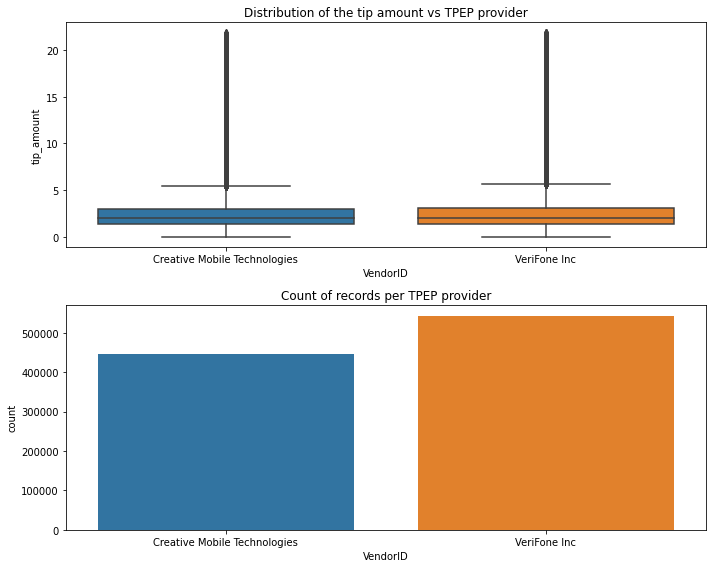

In [ ]:
fig,axs = plt.subplots(2,1,figsize=(10,8))

sns.boxplot(data=nyc_yellow_tripdata_df,x='VendorID',y='tip_amount',ax=axs[0])
sns.countplot(data=nyc_yellow_tripdata_df,x='VendorID',ax=axs[1])

axs[0].set_title('Distribution of the tip amount vs TPEP provider')
axs[1].set_title('Count of records per TPEP provider')

fig.tight_layout()

#Store final dataset

We save the final (sampled) dataframe

In [ ]:
nyc_yellow_tripdata_df.shape

(989833, 26)

In [ ]:
nyc_yellow_tripdata_df.to_csv(work_folder+"yellow_tripdata_clean_sample.csv",sep='|',index=False)